In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from sklearn.neighbors import NearestNeighbors

from tqdm.notebook import tqdm
from fastai.vision import *
from fastai.vision.gan import *
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import torchvision.models as models
import matplotlib.animation as animation
from IPython.display import HTML

from scipy import linalg
from torch.nn.functional import adaptive_avg_pool2d

from PIL import Image

import matplotlib.pyplot as plt
import sys
import numpy as np
import os
# print(os.listdir("../input"))

import time

In [3]:
# import torch
# torch.cuda.is_available = lambda : False
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [4]:
torch.cuda.is_available()

True

### <span style='font-family:Georgia'> Experiment setup

In [5]:
# Root directory for dataset
dataroot = untar_data(URLs.LSUN_BEDROOMS) #"./../data/test/data0/lsun/bedroom" # "./../../../../Downloads/archive/data0/lsun/bedroom" 
# dataroot = "./../data/test/data0/lsun/bedroom"  # TODO: zmiana elementu "test" w ścieżce na "sample"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 64

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 15

# Learning rate for optimizers
# lr = 0.0002

# Beta1 hyperparam for Adam optimizers
# beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

### <span style='font-family:Georgia'> Data

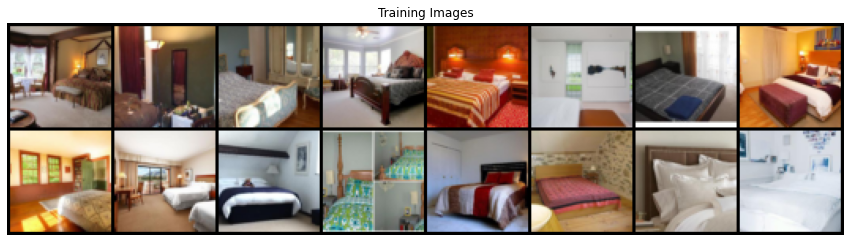

In [6]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
# device = torch.device("cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(15,12))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:16], padding=2, normalize=True).cpu(),(1,2,0)))

### <span style='font-family:Georgia'> Weight Initialization

In [7]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### <span style='font-family:Georgia'> Generator

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

### <span style='font-family:Georgia'> Discriminator

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# FID

def calculate_activation_statistics(images,model,batch_size=128, dims=2048,
                    cuda=False):
    model.eval()
    act=np.empty((len(images), dims))
    
    if cuda:
        batch=images.cuda()
    else:
        batch=images
    pred = model(batch)[0]

        # If model output is not scalar, apply global spatial average pooling.
        # This happens if you choose a dimensionality not equal 2048.
    if pred.size(2) != 1 or pred.size(3) != 1:
        pred = adaptive_avg_pool2d(pred, output_size=(1, 1))

    act= pred.cpu().data.numpy().reshape(pred.size(0), -1)
    
    mu = np.mean(act, axis=0)
    sigma = np.cov(act, rowvar=False)
    return mu, sigma


def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)


def calculate_fretchet(images_real,images_fake,model):
     mu_1,std_1=calculate_activation_statistics(images_real,model,cuda=True)
     mu_2,std_2=calculate_activation_statistics(images_fake,model,cuda=True)
    
     """get fretched distance"""
     fid_value = calculate_frechet_distance(mu_1, std_1, mu_2, std_2)
     return fid_value


import torchvision.models as models

class InceptionV3(nn.Module):
    """Pretrained InceptionV3 network returning feature maps"""

    # Index of default block of inception to return,
    # corresponds to output of final average pooling
    DEFAULT_BLOCK_INDEX = 3

    # Maps feature dimensionality to their output blocks indices
    BLOCK_INDEX_BY_DIM = {
        64: 0,   # First max pooling features
        192: 1,  # Second max pooling featurs
        768: 2,  # Pre-aux classifier features
        2048: 3  # Final average pooling features
    }

    def __init__(self,
                 output_blocks=[DEFAULT_BLOCK_INDEX],
                 resize_input=True,
                 normalize_input=True,
                 requires_grad=False):
        
        super(InceptionV3, self).__init__()

        self.resize_input = resize_input
        self.normalize_input = normalize_input
        self.output_blocks = sorted(output_blocks)
        self.last_needed_block = max(output_blocks)

        assert self.last_needed_block <= 3, \
            'Last possible output block index is 3'

        self.blocks = nn.ModuleList()

        
        inception = models.inception_v3(pretrained=True)

        # Block 0: input to maxpool1
        block0 = [
            inception.Conv2d_1a_3x3,
            inception.Conv2d_2a_3x3,
            inception.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2)
        ]
        self.blocks.append(nn.Sequential(*block0))

        # Block 1: maxpool1 to maxpool2
        if self.last_needed_block >= 1:
            block1 = [
                inception.Conv2d_3b_1x1,
                inception.Conv2d_4a_3x3,
                nn.MaxPool2d(kernel_size=3, stride=2)
            ]
            self.blocks.append(nn.Sequential(*block1))

        # Block 2: maxpool2 to aux classifier
        if self.last_needed_block >= 2:
            block2 = [
                inception.Mixed_5b,
                inception.Mixed_5c,
                inception.Mixed_5d,
                inception.Mixed_6a,
                inception.Mixed_6b,
                inception.Mixed_6c,
                inception.Mixed_6d,
                inception.Mixed_6e,
            ]
            self.blocks.append(nn.Sequential(*block2))

        # Block 3: aux classifier to final avgpool
        if self.last_needed_block >= 3:
            block3 = [
                inception.Mixed_7a,
                inception.Mixed_7b,
                inception.Mixed_7c,
                nn.AdaptiveAvgPool2d(output_size=(1, 1))
            ]
            self.blocks.append(nn.Sequential(*block3))

        for param in self.parameters():
            param.requires_grad = requires_grad

    def forward(self, inp):
        """Get Inception feature maps
        Parameters
        ----------
        inp : torch.autograd.Variable
            Input tensor of shape Bx3xHxW. Values are expected to be in
            range (0, 1)
        Returns
        -------
        List of torch.autograd.Variable, corresponding to the selected output
        block, sorted ascending by index
        """
        outp = []
        x = inp

        if self.resize_input:
            x = F.interpolate(x,
                              size=(299, 299),
                              mode='bilinear',
                              align_corners=False)

        if self.normalize_input:
            x = 2 * x - 1  # Scale from range (0, 1) to range (-1, 1)

        for idx, block in enumerate(self.blocks):
            x = block(x)
            if idx in self.output_blocks:
                outp.append(x)

            if idx == self.last_needed_block:
                break

        return outp
    
block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[2048]
model = InceptionV3([block_idx])
model=model.cuda()

### <span style='font-family:Georgia'> Loss Functions and Optimizers

In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
# fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
# optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))

# optimizerD = optim.RMSprop(netD.parameters(), lr=lr, alpha=0.99)
# optimizerG = optim.RMSprop(netG.parameters(), lr=lr, alpha=0.99)

### <span style='font-family:Georgia'> Training

Starting Training Loop...


  0%|          | 0/50 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/50][0/2369]	Loss_D: 1.6988	Loss_G: 4.4049	D(x): 0.4054	D(G(z)): 0.4286 / 0.0184
[0/50][500/2369]	Loss_D: 0.5797	Loss_G: 3.7553	D(x): 0.7136	D(G(z)): 0.1273 / 0.0317
[0/50][1000/2369]	Loss_D: 0.3221	Loss_G: 5.0193	D(x): 0.9296	D(G(z)): 0.1768 / 0.0116
[0/50][1500/2369]	Loss_D: 0.2304	Loss_G: 3.8894	D(x): 0.9102	D(G(z)): 0.1076 / 0.0372
[0/50][2000/2369]	Loss_D: 0.5953	Loss_G: 3.2186	D(x): 0.6567	D(G(z)): 0.0160 / 0.0720


0it [00:00, ?it/s]

[1/50][0/2369]	Loss_D: 0.8693	Loss_G: 9.7888	D(x): 0.9662	D(G(z)): 0.4847 / 0.0002
[1/50][500/2369]	Loss_D: 0.5430	Loss_G: 1.4313	D(x): 0.6817	D(G(z)): 0.0537 / 0.3081
[1/50][1000/2369]	Loss_D: 0.1969	Loss_G: 3.3742	D(x): 0.9829	D(G(z)): 0.1519 / 0.0574
[1/50][1500/2369]	Loss_D: 0.1599	Loss_G: 4.0091	D(x): 0.8993	D(G(z)): 0.0445 / 0.0298
[1/50][2000/2369]	Loss_D: 0.2100	Loss_G: 3.9888	D(x): 0.8744	D(G(z)): 0.0547 / 0.0296


0it [00:00, ?it/s]

[2/50][0/2369]	Loss_D: 0.8952	Loss_G: 7.2900	D(x): 0.9906	D(G(z)): 0.5286 / 0.0012
[2/50][500/2369]	Loss_D: 0.3896	Loss_G: 5.0407	D(x): 0.9184	D(G(z)): 0.2161 / 0.0110
[2/50][1000/2369]	Loss_D: 0.1779	Loss_G: 3.0416	D(x): 0.9123	D(G(z)): 0.0717 / 0.0677
[2/50][1500/2369]	Loss_D: 0.2688	Loss_G: 3.4386	D(x): 0.9153	D(G(z)): 0.1489 / 0.0442
[2/50][2000/2369]	Loss_D: 0.2948	Loss_G: 3.2632	D(x): 0.8625	D(G(z)): 0.1176 / 0.0519


0it [00:00, ?it/s]

[3/50][0/2369]	Loss_D: 0.8118	Loss_G: 5.5199	D(x): 0.9565	D(G(z)): 0.4377 / 0.0107
[3/50][500/2369]	Loss_D: 0.2596	Loss_G: 3.0615	D(x): 0.8726	D(G(z)): 0.1004 / 0.0638
[3/50][1000/2369]	Loss_D: 0.2677	Loss_G: 3.1855	D(x): 0.8251	D(G(z)): 0.0496 / 0.0634
[3/50][1500/2369]	Loss_D: 0.8127	Loss_G: 3.4812	D(x): 0.5319	D(G(z)): 0.0071 / 0.0518
[3/50][2000/2369]	Loss_D: 0.3056	Loss_G: 2.8170	D(x): 0.8917	D(G(z)): 0.1582 / 0.0820


0it [00:00, ?it/s]

[4/50][0/2369]	Loss_D: 0.3133	Loss_G: 5.2563	D(x): 0.9432	D(G(z)): 0.1981 / 0.0091
[4/50][500/2369]	Loss_D: 0.8480	Loss_G: 1.3730	D(x): 0.5117	D(G(z)): 0.0491 / 0.3186
[4/50][1000/2369]	Loss_D: 0.2454	Loss_G: 2.6013	D(x): 0.8877	D(G(z)): 0.1070 / 0.1083
[4/50][1500/2369]	Loss_D: 0.3615	Loss_G: 2.8308	D(x): 0.7731	D(G(z)): 0.0471 / 0.0972
[4/50][2000/2369]	Loss_D: 0.2731	Loss_G: 3.6660	D(x): 0.9339	D(G(z)): 0.1657 / 0.0383
[5/50]	Loss_D: 0.2753	Loss_G: 4.8658	Fretchet_Distance: 243.3995


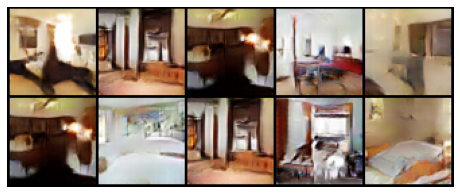

0it [00:00, ?it/s]

[5/50][0/2369]	Loss_D: 0.2528	Loss_G: 3.2012	D(x): 0.8738	D(G(z)): 0.0913 / 0.0608
[5/50][500/2369]	Loss_D: 0.2657	Loss_G: 3.9515	D(x): 0.9377	D(G(z)): 0.1680 / 0.0260
[5/50][1000/2369]	Loss_D: 1.2303	Loss_G: 0.4818	D(x): 0.4000	D(G(z)): 0.0413 / 0.6862
[5/50][1500/2369]	Loss_D: 0.2422	Loss_G: 4.0600	D(x): 0.9562	D(G(z)): 0.1623 / 0.0248
[5/50][2000/2369]	Loss_D: 0.2162	Loss_G: 2.6437	D(x): 0.8731	D(G(z)): 0.0618 / 0.1101


0it [00:00, ?it/s]

[6/50][0/2369]	Loss_D: 0.2598	Loss_G: 4.3133	D(x): 0.9471	D(G(z)): 0.1659 / 0.0215
[6/50][500/2369]	Loss_D: 0.1037	Loss_G: 3.8080	D(x): 0.9506	D(G(z)): 0.0482 / 0.0360
[6/50][1000/2369]	Loss_D: 0.2679	Loss_G: 4.0834	D(x): 0.9406	D(G(z)): 0.1676 / 0.0242
[6/50][1500/2369]	Loss_D: 0.2320	Loss_G: 4.9260	D(x): 0.9768	D(G(z)): 0.1746 / 0.0098
[6/50][2000/2369]	Loss_D: 0.2742	Loss_G: 3.4679	D(x): 0.9262	D(G(z)): 0.1606 / 0.0464


0it [00:00, ?it/s]

[7/50][0/2369]	Loss_D: 0.1609	Loss_G: 5.2652	D(x): 0.9853	D(G(z)): 0.1240 / 0.0089
[7/50][500/2369]	Loss_D: 0.3395	Loss_G: 4.1944	D(x): 0.9424	D(G(z)): 0.2165 / 0.0222
[7/50][1000/2369]	Loss_D: 0.2776	Loss_G: 3.0767	D(x): 0.8630	D(G(z)): 0.1002 / 0.0684
[7/50][1500/2369]	Loss_D: 0.2120	Loss_G: 3.9492	D(x): 0.9514	D(G(z)): 0.1296 / 0.0288
[7/50][2000/2369]	Loss_D: 0.3997	Loss_G: 2.8663	D(x): 0.7482	D(G(z)): 0.0476 / 0.1000


0it [00:00, ?it/s]

[8/50][0/2369]	Loss_D: 0.1891	Loss_G: 4.3234	D(x): 0.9675	D(G(z)): 0.1311 / 0.0207
[8/50][500/2369]	Loss_D: 0.2433	Loss_G: 4.0773	D(x): 0.9551	D(G(z)): 0.1675 / 0.0234
[8/50][1000/2369]	Loss_D: 0.1595	Loss_G: 3.2199	D(x): 0.8772	D(G(z)): 0.0142 / 0.0633
[8/50][1500/2369]	Loss_D: 0.1758	Loss_G: 4.2944	D(x): 0.9713	D(G(z)): 0.1224 / 0.0206
[8/50][2000/2369]	Loss_D: 0.1528	Loss_G: 4.5527	D(x): 0.9118	D(G(z)): 0.0475 / 0.0171


0it [00:00, ?it/s]

[9/50][0/2369]	Loss_D: 0.2221	Loss_G: 3.8309	D(x): 0.8773	D(G(z)): 0.0689 / 0.0477
[9/50][500/2369]	Loss_D: 0.1076	Loss_G: 3.8217	D(x): 0.9304	D(G(z)): 0.0268 / 0.0382
[9/50][1000/2369]	Loss_D: 0.2522	Loss_G: 1.3879	D(x): 0.8285	D(G(z)): 0.0431 / 0.3339
[9/50][1500/2369]	Loss_D: 0.1161	Loss_G: 4.0563	D(x): 0.9647	D(G(z)): 0.0726 / 0.0274
[9/50][2000/2369]	Loss_D: 0.2267	Loss_G: 4.8579	D(x): 0.9739	D(G(z)): 0.1633 / 0.0118
[10/50]	Loss_D: 0.8913	Loss_G: 1.4461	Fretchet_Distance: 205.7065


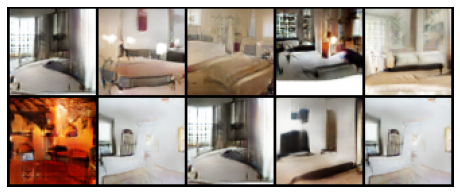

0it [00:00, ?it/s]

[10/50][0/2369]	Loss_D: 1.2505	Loss_G: 4.2053	D(x): 0.9571	D(G(z)): 0.6139 / 0.0300
[10/50][500/2369]	Loss_D: 0.0510	Loss_G: 4.5123	D(x): 0.9755	D(G(z)): 0.0251 / 0.0208
[10/50][1000/2369]	Loss_D: 0.0549	Loss_G: 4.0499	D(x): 0.9690	D(G(z)): 0.0218 / 0.0263
[10/50][1500/2369]	Loss_D: 0.0868	Loss_G: 4.7429	D(x): 0.9822	D(G(z)): 0.0634 / 0.0140
[10/50][2000/2369]	Loss_D: 0.2270	Loss_G: 3.1770	D(x): 0.9207	D(G(z)): 0.1205 / 0.0661


0it [00:00, ?it/s]

[11/50][0/2369]	Loss_D: 0.4264	Loss_G: 6.7469	D(x): 0.9913	D(G(z)): 0.2938 / 0.0021
[11/50][500/2369]	Loss_D: 0.0894	Loss_G: 4.7458	D(x): 0.9831	D(G(z)): 0.0653 / 0.0135
[11/50][1000/2369]	Loss_D: 0.1095	Loss_G: 3.3598	D(x): 0.9359	D(G(z)): 0.0363 / 0.0580
[11/50][1500/2369]	Loss_D: 0.1330	Loss_G: 4.9171	D(x): 0.9640	D(G(z)): 0.0814 / 0.0134
[11/50][2000/2369]	Loss_D: 2.1810	Loss_G: 0.6469	D(x): 0.2004	D(G(z)): 0.0766 / 0.5871


0it [00:00, ?it/s]

[12/50][0/2369]	Loss_D: 0.0785	Loss_G: 4.3013	D(x): 0.9795	D(G(z)): 0.0538 / 0.0205
[12/50][500/2369]	Loss_D: 0.0783	Loss_G: 3.4169	D(x): 0.9504	D(G(z)): 0.0238 / 0.0544
[12/50][1000/2369]	Loss_D: 0.1544	Loss_G: 3.4727	D(x): 0.8928	D(G(z)): 0.0306 / 0.0570
[12/50][1500/2369]	Loss_D: 0.1094	Loss_G: 4.2066	D(x): 0.9256	D(G(z)): 0.0264 / 0.0251
[12/50][2000/2369]	Loss_D: 0.9062	Loss_G: 1.4347	D(x): 0.5267	D(G(z)): 0.1073 / 0.3076


0it [00:00, ?it/s]

[13/50][0/2369]	Loss_D: 0.2600	Loss_G: 4.0011	D(x): 0.8048	D(G(z)): 0.0076 / 0.0440
[13/50][500/2369]	Loss_D: 0.3958	Loss_G: 3.6089	D(x): 0.9141	D(G(z)): 0.2209 / 0.0432
[13/50][1000/2369]	Loss_D: 0.0661	Loss_G: 4.9357	D(x): 0.9817	D(G(z)): 0.0444 / 0.0129
[13/50][1500/2369]	Loss_D: 0.6210	Loss_G: 5.8318	D(x): 0.9854	D(G(z)): 0.3916 / 0.0047
[13/50][2000/2369]	Loss_D: 0.0529	Loss_G: 4.4620	D(x): 0.9631	D(G(z)): 0.0139 / 0.0203


0it [00:00, ?it/s]

[14/50][0/2369]	Loss_D: 0.4022	Loss_G: 8.1386	D(x): 0.9981	D(G(z)): 0.2871 / 0.0005
[14/50][500/2369]	Loss_D: 1.2021	Loss_G: 3.4666	D(x): 0.9239	D(G(z)): 0.5989 / 0.0487
[14/50][1000/2369]	Loss_D: 0.0253	Loss_G: 4.8792	D(x): 0.9940	D(G(z)): 0.0185 / 0.0143
[14/50][1500/2369]	Loss_D: 0.2529	Loss_G: 5.4624	D(x): 0.9706	D(G(z)): 0.1731 / 0.0069
[14/50][2000/2369]	Loss_D: 0.3062	Loss_G: 6.2468	D(x): 0.9534	D(G(z)): 0.1927 / 0.0038
[15/50]	Loss_D: 1.8377	Loss_G: 0.0655	Fretchet_Distance: 199.9775


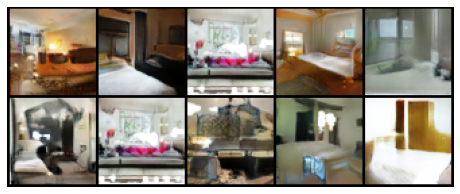

0it [00:00, ?it/s]

[15/50][0/2369]	Loss_D: 3.9479	Loss_G: 11.0685	D(x): 0.9998	D(G(z)): 0.9431 / 0.0001
[15/50][500/2369]	Loss_D: 0.2314	Loss_G: 4.2008	D(x): 0.9300	D(G(z)): 0.1272 / 0.0261
[15/50][1000/2369]	Loss_D: 0.0877	Loss_G: 4.0947	D(x): 0.9560	D(G(z)): 0.0386 / 0.0270
[15/50][1500/2369]	Loss_D: 0.1991	Loss_G: 4.6730	D(x): 0.9227	D(G(z)): 0.0924 / 0.0192
[15/50][2000/2369]	Loss_D: 0.4621	Loss_G: 2.4612	D(x): 0.7032	D(G(z)): 0.0306 / 0.1688


0it [00:00, ?it/s]

[16/50][0/2369]	Loss_D: 0.9890	Loss_G: 0.3489	D(x): 0.5123	D(G(z)): 0.0869 / 0.7562
[16/50][500/2369]	Loss_D: 0.0420	Loss_G: 5.4351	D(x): 0.9783	D(G(z)): 0.0184 / 0.0097
[16/50][1000/2369]	Loss_D: 0.0620	Loss_G: 4.2094	D(x): 0.9556	D(G(z)): 0.0144 / 0.0278
[16/50][1500/2369]	Loss_D: 0.2697	Loss_G: 2.6279	D(x): 0.8480	D(G(z)): 0.0606 / 0.1173
[16/50][2000/2369]	Loss_D: 0.2756	Loss_G: 4.6824	D(x): 0.9140	D(G(z)): 0.1427 / 0.0179


0it [00:00, ?it/s]

[17/50][0/2369]	Loss_D: 0.1293	Loss_G: 3.7623	D(x): 0.8964	D(G(z)): 0.0061 / 0.0505
[17/50][500/2369]	Loss_D: 0.1173	Loss_G: 4.4637	D(x): 0.9025	D(G(z)): 0.0052 / 0.0266
[17/50][1000/2369]	Loss_D: 0.0586	Loss_G: 4.4694	D(x): 0.9706	D(G(z)): 0.0267 / 0.0203
[17/50][1500/2369]	Loss_D: 0.0537	Loss_G: 4.7349	D(x): 0.9694	D(G(z)): 0.0204 / 0.0159
[17/50][2000/2369]	Loss_D: 0.1538	Loss_G: 6.4622	D(x): 0.9914	D(G(z)): 0.1218 / 0.0029


0it [00:00, ?it/s]

[18/50][0/2369]	Loss_D: 0.6491	Loss_G: 0.9676	D(x): 0.6377	D(G(z)): 0.0473 / 0.4922
[18/50][500/2369]	Loss_D: 0.0645	Loss_G: 4.7604	D(x): 0.9545	D(G(z)): 0.0150 / 0.0202
[18/50][1000/2369]	Loss_D: 0.8625	Loss_G: 1.3705	D(x): 0.5445	D(G(z)): 0.0977 / 0.3539
[18/50][1500/2369]	Loss_D: 0.0381	Loss_G: 4.3901	D(x): 0.9767	D(G(z)): 0.0135 / 0.0241
[18/50][2000/2369]	Loss_D: 0.4096	Loss_G: 2.8329	D(x): 0.7893	D(G(z)): 0.1006 / 0.1063


0it [00:00, ?it/s]

[19/50][0/2369]	Loss_D: 0.1514	Loss_G: 6.8323	D(x): 0.9965	D(G(z)): 0.1227 / 0.0018
[19/50][500/2369]	Loss_D: 1.4286	Loss_G: 12.9651	D(x): 0.9980	D(G(z)): 0.6488 / 0.0000
[19/50][1000/2369]	Loss_D: 0.0261	Loss_G: 5.0878	D(x): 0.9843	D(G(z)): 0.0099 / 0.0128
[19/50][1500/2369]	Loss_D: 0.0173	Loss_G: 5.8885	D(x): 0.9942	D(G(z)): 0.0112 / 0.0060
[19/50][2000/2369]	Loss_D: 0.1245	Loss_G: 4.2633	D(x): 0.9056	D(G(z)): 0.0133 / 0.0328
[20/50]	Loss_D: 0.0329	Loss_G: 5.4835	Fretchet_Distance: 204.0533


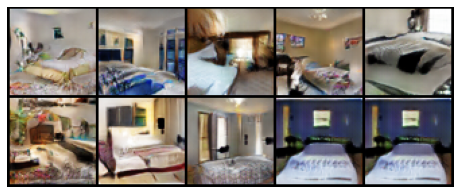

0it [00:00, ?it/s]

[20/50][0/2369]	Loss_D: 0.0360	Loss_G: 5.1583	D(x): 0.9798	D(G(z)): 0.0121 / 0.0121
[20/50][500/2369]	Loss_D: 0.0588	Loss_G: 4.6192	D(x): 0.9746	D(G(z)): 0.0303 / 0.0215
[20/50][1000/2369]	Loss_D: 0.0231	Loss_G: 5.3823	D(x): 0.9948	D(G(z)): 0.0175 / 0.0088
[20/50][1500/2369]	Loss_D: 0.0373	Loss_G: 5.3465	D(x): 0.9789	D(G(z)): 0.0151 / 0.0096
[20/50][2000/2369]	Loss_D: 0.1248	Loss_G: 4.4678	D(x): 0.9360	D(G(z)): 0.0469 / 0.0271


0it [00:00, ?it/s]

[21/50][0/2369]	Loss_D: 0.0431	Loss_G: 6.0899	D(x): 0.9659	D(G(z)): 0.0072 / 0.0071
[21/50][500/2369]	Loss_D: 0.0311	Loss_G: 5.5942	D(x): 0.9914	D(G(z)): 0.0212 / 0.0071
[21/50][1000/2369]	Loss_D: 0.0433	Loss_G: 5.1087	D(x): 0.9930	D(G(z)): 0.0339 / 0.0119
[21/50][1500/2369]	Loss_D: 0.0236	Loss_G: 5.6077	D(x): 0.9866	D(G(z)): 0.0098 / 0.0078
[21/50][2000/2369]	Loss_D: 0.0365	Loss_G: 5.0874	D(x): 0.9877	D(G(z)): 0.0227 / 0.0117


0it [00:00, ?it/s]

[22/50][0/2369]	Loss_D: 0.1417	Loss_G: 3.7580	D(x): 0.8936	D(G(z)): 0.0194 / 0.0508
[22/50][500/2369]	Loss_D: 0.8520	Loss_G: 3.5138	D(x): 0.8714	D(G(z)): 0.3860 / 0.0600
[22/50][1000/2369]	Loss_D: 0.0495	Loss_G: 4.6198	D(x): 0.9860	D(G(z)): 0.0305 / 0.0177
[22/50][1500/2369]	Loss_D: 0.0284	Loss_G: 4.7570	D(x): 0.9850	D(G(z)): 0.0114 / 0.0156
[22/50][2000/2369]	Loss_D: 0.0194	Loss_G: 5.3856	D(x): 0.9932	D(G(z)): 0.0118 / 0.0103


0it [00:00, ?it/s]

[23/50][0/2369]	Loss_D: 0.0221	Loss_G: 6.2851	D(x): 0.9919	D(G(z)): 0.0129 / 0.0048
[23/50][500/2369]	Loss_D: 0.2123	Loss_G: 5.0789	D(x): 0.9390	D(G(z)): 0.1175 / 0.0123
[23/50][1000/2369]	Loss_D: 0.5093	Loss_G: 2.5745	D(x): 0.7602	D(G(z)): 0.1306 / 0.1175
[23/50][1500/2369]	Loss_D: 0.0517	Loss_G: 5.0906	D(x): 0.9817	D(G(z)): 0.0310 / 0.0119
[23/50][2000/2369]	Loss_D: 0.0946	Loss_G: 3.6280	D(x): 0.9270	D(G(z)): 0.0145 / 0.0502


0it [00:00, ?it/s]

[24/50][0/2369]	Loss_D: 0.0181	Loss_G: 5.6172	D(x): 0.9973	D(G(z)): 0.0151 / 0.0079
[24/50][500/2369]	Loss_D: 0.0311	Loss_G: 5.9565	D(x): 0.9784	D(G(z)): 0.0081 / 0.0062
[24/50][1000/2369]	Loss_D: 0.0562	Loss_G: 5.0929	D(x): 0.9640	D(G(z)): 0.0176 / 0.0139
[24/50][1500/2369]	Loss_D: 0.0196	Loss_G: 6.0953	D(x): 0.9864	D(G(z)): 0.0057 / 0.0047
[24/50][2000/2369]	Loss_D: 0.0343	Loss_G: 5.4933	D(x): 0.9865	D(G(z)): 0.0196 / 0.0094
[25/50]	Loss_D: 0.2723	Loss_G: 1.5568	Fretchet_Distance: 205.4862


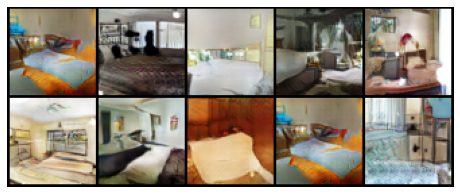

0it [00:00, ?it/s]

[25/50][0/2369]	Loss_D: 0.8830	Loss_G: 13.8055	D(x): 0.9996	D(G(z)): 0.4922 / 0.0000
[25/50][500/2369]	Loss_D: 0.0164	Loss_G: 5.9142	D(x): 0.9940	D(G(z)): 0.0102 / 0.0053
[25/50][1000/2369]	Loss_D: 0.0240	Loss_G: 5.5965	D(x): 0.9847	D(G(z)): 0.0081 / 0.0080
[25/50][1500/2369]	Loss_D: 0.0437	Loss_G: 4.7520	D(x): 0.9788	D(G(z)): 0.0209 / 0.0184
[25/50][2000/2369]	Loss_D: 0.0706	Loss_G: 5.8884	D(x): 0.9878	D(G(z)): 0.0463 / 0.0054


0it [00:00, ?it/s]

[26/50][0/2369]	Loss_D: 0.0175	Loss_G: 5.9722	D(x): 0.9943	D(G(z)): 0.0114 / 0.0058
[26/50][500/2369]	Loss_D: 0.0565	Loss_G: 4.3491	D(x): 0.9678	D(G(z)): 0.0206 / 0.0259
[26/50][1000/2369]	Loss_D: 0.0646	Loss_G: 6.0316	D(x): 0.9905	D(G(z)): 0.0474 / 0.0055
[26/50][1500/2369]	Loss_D: 0.0265	Loss_G: 6.0248	D(x): 0.9871	D(G(z)): 0.0123 / 0.0069
[26/50][2000/2369]	Loss_D: 0.0325	Loss_G: 5.0883	D(x): 0.9752	D(G(z)): 0.0062 / 0.0142


0it [00:00, ?it/s]

[27/50][0/2369]	Loss_D: 0.3153	Loss_G: 3.4473	D(x): 0.8632	D(G(z)): 0.0944 / 0.0622
[27/50][500/2369]	Loss_D: 0.0326	Loss_G: 6.1110	D(x): 0.9757	D(G(z)): 0.0074 / 0.0059
[27/50][1000/2369]	Loss_D: 0.0388	Loss_G: 5.1962	D(x): 0.9705	D(G(z)): 0.0077 / 0.0127
[27/50][1500/2369]	Loss_D: 0.0132	Loss_G: 5.8479	D(x): 0.9961	D(G(z)): 0.0092 / 0.0052
[27/50][2000/2369]	Loss_D: 0.5079	Loss_G: 2.8615	D(x): 0.7782	D(G(z)): 0.1619 / 0.0981


0it [00:00, ?it/s]

[28/50][0/2369]	Loss_D: 0.0465	Loss_G: 5.1865	D(x): 0.9792	D(G(z)): 0.0235 / 0.0137
[28/50][500/2369]	Loss_D: 0.0242	Loss_G: 5.7479	D(x): 0.9974	D(G(z)): 0.0206 / 0.0073
[28/50][1000/2369]	Loss_D: 0.0177	Loss_G: 6.0117	D(x): 0.9963	D(G(z)): 0.0136 / 0.0049
[28/50][1500/2369]	Loss_D: 0.0749	Loss_G: 5.2816	D(x): 0.9688	D(G(z)): 0.0312 / 0.0140
[28/50][2000/2369]	Loss_D: 0.1525	Loss_G: 3.2254	D(x): 0.8833	D(G(z)): 0.0050 / 0.1001


0it [00:00, ?it/s]

[29/50][0/2369]	Loss_D: 0.6364	Loss_G: 13.7501	D(x): 0.9998	D(G(z)): 0.3886 / 0.0000
[29/50][500/2369]	Loss_D: 0.0730	Loss_G: 5.0448	D(x): 0.9671	D(G(z)): 0.0355 / 0.0172
[29/50][1000/2369]	Loss_D: 0.0172	Loss_G: 6.2415	D(x): 0.9930	D(G(z)): 0.0098 / 0.0049
[29/50][1500/2369]	Loss_D: 0.0235	Loss_G: 6.3854	D(x): 0.9925	D(G(z)): 0.0151 / 0.0044
[29/50][2000/2369]	Loss_D: 0.0408	Loss_G: 4.4472	D(x): 0.9951	D(G(z)): 0.0337 / 0.0259
[30/50]	Loss_D: 0.6001	Loss_G: 5.1146	Fretchet_Distance: 195.9765


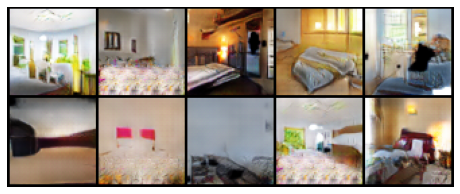

0it [00:00, ?it/s]

[30/50][0/2369]	Loss_D: 0.4511	Loss_G: 3.0092	D(x): 0.7791	D(G(z)): 0.1033 / 0.0932
[30/50][500/2369]	Loss_D: 0.0349	Loss_G: 5.1890	D(x): 0.9760	D(G(z)): 0.0096 / 0.0137
[30/50][1000/2369]	Loss_D: 0.0261	Loss_G: 5.5464	D(x): 0.9892	D(G(z)): 0.0146 / 0.0076
[30/50][1500/2369]	Loss_D: 0.0348	Loss_G: 5.3885	D(x): 0.9882	D(G(z)): 0.0218 / 0.0100
[30/50][2000/2369]	Loss_D: 0.1137	Loss_G: 3.6254	D(x): 0.9058	D(G(z)): 0.0030 / 0.0605


0it [00:00, ?it/s]

[31/50][0/2369]	Loss_D: 0.1761	Loss_G: 4.2190	D(x): 0.9051	D(G(z)): 0.0541 / 0.0395
[31/50][500/2369]	Loss_D: 0.0418	Loss_G: 5.7078	D(x): 0.9919	D(G(z)): 0.0292 / 0.0071
[31/50][1000/2369]	Loss_D: 0.0283	Loss_G: 5.5340	D(x): 0.9817	D(G(z)): 0.0092 / 0.0090
[31/50][1500/2369]	Loss_D: 0.0254	Loss_G: 5.5988	D(x): 0.9901	D(G(z)): 0.0146 / 0.0081
[31/50][2000/2369]	Loss_D: 1.5748	Loss_G: 5.7955	D(x): 0.9850	D(G(z)): 0.6557 / 0.0086


0it [00:00, ?it/s]

[32/50][0/2369]	Loss_D: 0.0605	Loss_G: 4.8788	D(x): 0.9485	D(G(z)): 0.0049 / 0.0212
[32/50][500/2369]	Loss_D: 0.2872	Loss_G: 3.2364	D(x): 0.7968	D(G(z)): 0.0140 / 0.0861
[32/50][1000/2369]	Loss_D: 0.0133	Loss_G: 6.2024	D(x): 0.9963	D(G(z)): 0.0092 / 0.0059
[32/50][1500/2369]	Loss_D: 0.0380	Loss_G: 5.2312	D(x): 0.9749	D(G(z)): 0.0103 / 0.0121
[32/50][2000/2369]	Loss_D: 0.0246	Loss_G: 5.7830	D(x): 0.9919	D(G(z)): 0.0157 / 0.0084


0it [00:00, ?it/s]

[33/50][0/2369]	Loss_D: 0.0826	Loss_G: 7.7047	D(x): 0.9994	D(G(z)): 0.0699 / 0.0008
[33/50][500/2369]	Loss_D: 0.1381	Loss_G: 6.7944	D(x): 0.9970	D(G(z)): 0.1140 / 0.0022
[33/50][1000/2369]	Loss_D: 0.0388	Loss_G: 5.1952	D(x): 0.9760	D(G(z)): 0.0132 / 0.0152
[33/50][1500/2369]	Loss_D: 0.0486	Loss_G: 5.9309	D(x): 0.9578	D(G(z)): 0.0033 / 0.0063
[33/50][2000/2369]	Loss_D: 0.0121	Loss_G: 7.2982	D(x): 0.9895	D(G(z)): 0.0014 / 0.0016


0it [00:00, ?it/s]

[34/50][0/2369]	Loss_D: 0.0427	Loss_G: 6.3763	D(x): 0.9623	D(G(z)): 0.0022 / 0.0055
[34/50][500/2369]	Loss_D: 0.0344	Loss_G: 6.0514	D(x): 0.9919	D(G(z)): 0.0250 / 0.0071
[34/50][1000/2369]	Loss_D: 0.4014	Loss_G: 3.5868	D(x): 0.8509	D(G(z)): 0.1660 / 0.0536
[34/50][1500/2369]	Loss_D: 0.0185	Loss_G: 6.1454	D(x): 0.9892	D(G(z)): 0.0071 / 0.0060
[34/50][2000/2369]	Loss_D: 3.3277	Loss_G: 7.4956	D(x): 0.9936	D(G(z)): 0.9077 / 0.0038
[35/50]	Loss_D: 0.0750	Loss_G: 10.0401	Fretchet_Distance: 203.8005


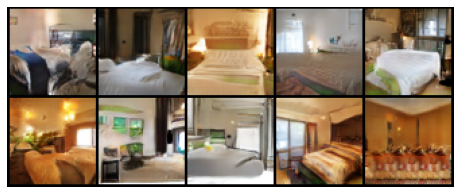

0it [00:00, ?it/s]

[35/50][0/2369]	Loss_D: 0.0348	Loss_G: 6.1316	D(x): 0.9762	D(G(z)): 0.0100 / 0.0066
[35/50][500/2369]	Loss_D: 0.2236	Loss_G: 3.5869	D(x): 0.8595	D(G(z)): 0.0423 / 0.0669
[35/50][1000/2369]	Loss_D: 0.0116	Loss_G: 6.6400	D(x): 0.9938	D(G(z)): 0.0053 / 0.0030
[35/50][1500/2369]	Loss_D: 1.0487	Loss_G: 8.3651	D(x): 0.9763	D(G(z)): 0.5306 / 0.0006
[35/50][2000/2369]	Loss_D: 0.0258	Loss_G: 5.9021	D(x): 0.9895	D(G(z)): 0.0145 / 0.0063


0it [00:00, ?it/s]

[36/50][0/2369]	Loss_D: 0.0759	Loss_G: 6.3120	D(x): 0.9980	D(G(z)): 0.0677 / 0.0032
[36/50][500/2369]	Loss_D: 0.0740	Loss_G: 4.4937	D(x): 0.9462	D(G(z)): 0.0128 / 0.0275
[36/50][1000/2369]	Loss_D: 0.0435	Loss_G: 5.5860	D(x): 0.9650	D(G(z)): 0.0052 / 0.0094
[36/50][1500/2369]	Loss_D: 0.0307	Loss_G: 5.5601	D(x): 0.9816	D(G(z)): 0.0114 / 0.0087
[36/50][2000/2369]	Loss_D: 0.0454	Loss_G: 6.0384	D(x): 0.9978	D(G(z)): 0.0382 / 0.0067


0it [00:00, ?it/s]

[37/50][0/2369]	Loss_D: 0.0270	Loss_G: 5.8918	D(x): 0.9980	D(G(z)): 0.0232 / 0.0062
[37/50][500/2369]	Loss_D: 0.0511	Loss_G: 6.7867	D(x): 0.9946	D(G(z)): 0.0388 / 0.0034
[37/50][1000/2369]	Loss_D: 0.1463	Loss_G: 4.4918	D(x): 0.9092	D(G(z)): 0.0338 / 0.0281
[37/50][1500/2369]	Loss_D: 0.0507	Loss_G: 5.0365	D(x): 0.9683	D(G(z)): 0.0163 / 0.0158
[37/50][2000/2369]	Loss_D: 0.2764	Loss_G: 3.9281	D(x): 0.9099	D(G(z)): 0.1342 / 0.0372


0it [00:00, ?it/s]

[38/50][0/2369]	Loss_D: 0.0210	Loss_G: 5.8360	D(x): 0.9847	D(G(z)): 0.0051 / 0.0077
[38/50][500/2369]	Loss_D: 0.0743	Loss_G: 4.6410	D(x): 0.9625	D(G(z)): 0.0305 / 0.0249
[38/50][1000/2369]	Loss_D: 0.6400	Loss_G: 2.0783	D(x): 0.7035	D(G(z)): 0.1453 / 0.2032
[38/50][1500/2369]	Loss_D: 0.0499	Loss_G: 5.1140	D(x): 0.9973	D(G(z)): 0.0436 / 0.0120
[38/50][2000/2369]	Loss_D: 2.2143	Loss_G: 0.6373	D(x): 0.2172	D(G(z)): 0.0090 / 0.7385


0it [00:00, ?it/s]

[39/50][0/2369]	Loss_D: 0.0358	Loss_G: 5.4921	D(x): 0.9718	D(G(z)): 0.0055 / 0.0099
[39/50][500/2369]	Loss_D: 0.0170	Loss_G: 5.7314	D(x): 0.9933	D(G(z)): 0.0099 / 0.0097
[39/50][1000/2369]	Loss_D: 0.0151	Loss_G: 6.0701	D(x): 0.9906	D(G(z)): 0.0055 / 0.0056
[39/50][1500/2369]	Loss_D: 0.0121	Loss_G: 6.2248	D(x): 0.9954	D(G(z)): 0.0073 / 0.0056
[39/50][2000/2369]	Loss_D: 0.0231	Loss_G: 6.8306	D(x): 0.9799	D(G(z)): 0.0021 / 0.0037
[40/50]	Loss_D: 0.3717	Loss_G: 0.2227	Fretchet_Distance: 192.3370


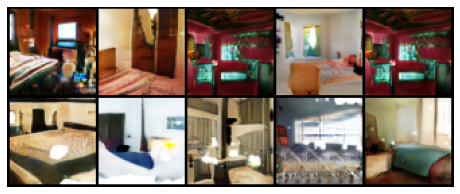

0it [00:00, ?it/s]

[40/50][0/2369]	Loss_D: 2.6062	Loss_G: 16.2578	D(x): 1.0000	D(G(z)): 0.8214 / 0.0000
[40/50][500/2369]	Loss_D: 0.0149	Loss_G: 6.5079	D(x): 0.9913	D(G(z)): 0.0059 / 0.0044
[40/50][1000/2369]	Loss_D: 0.0114	Loss_G: 6.7267	D(x): 0.9981	D(G(z)): 0.0092 / 0.0038
[40/50][1500/2369]	Loss_D: 0.0237	Loss_G: 6.3750	D(x): 0.9822	D(G(z)): 0.0049 / 0.0049
[40/50][2000/2369]	Loss_D: 0.0232	Loss_G: 5.6083	D(x): 0.9934	D(G(z)): 0.0157 / 0.0096


0it [00:00, ?it/s]

[41/50][0/2369]	Loss_D: 0.0258	Loss_G: 6.0361	D(x): 0.9995	D(G(z)): 0.0234 / 0.0062
[41/50][500/2369]	Loss_D: 0.0397	Loss_G: 5.2300	D(x): 0.9686	D(G(z)): 0.0060 / 0.0141
[41/50][1000/2369]	Loss_D: 0.0409	Loss_G: 6.4170	D(x): 0.9663	D(G(z)): 0.0030 / 0.0068
[41/50][1500/2369]	Loss_D: 0.0043	Loss_G: 7.5045	D(x): 0.9983	D(G(z)): 0.0026 / 0.0015
[41/50][2000/2369]	Loss_D: 0.3040	Loss_G: 4.6938	D(x): 0.9366	D(G(z)): 0.1655 / 0.0218


0it [00:00, ?it/s]

[42/50][0/2369]	Loss_D: 0.0289	Loss_G: 6.4548	D(x): 0.9970	D(G(z)): 0.0244 / 0.0045
[42/50][500/2369]	Loss_D: 0.0773	Loss_G: 4.2091	D(x): 0.9678	D(G(z)): 0.0400 / 0.0314
[42/50][1000/2369]	Loss_D: 0.0350	Loss_G: 5.2775	D(x): 0.9807	D(G(z)): 0.0137 / 0.0133
[42/50][1500/2369]	Loss_D: 0.0130	Loss_G: 6.1783	D(x): 0.9952	D(G(z)): 0.0080 / 0.0046
[42/50][2000/2369]	Loss_D: 0.0280	Loss_G: 5.9790	D(x): 0.9894	D(G(z)): 0.0167 / 0.0061


0it [00:00, ?it/s]

[43/50][0/2369]	Loss_D: 0.0777	Loss_G: 6.1216	D(x): 0.9964	D(G(z)): 0.0661 / 0.0042
[43/50][500/2369]	Loss_D: 0.0188	Loss_G: 6.0730	D(x): 0.9932	D(G(z)): 0.0113 / 0.0063
[43/50][1000/2369]	Loss_D: 0.0248	Loss_G: 5.6952	D(x): 0.9918	D(G(z)): 0.0154 / 0.0087
[43/50][1500/2369]	Loss_D: 0.0271	Loss_G: 5.6253	D(x): 0.9900	D(G(z)): 0.0162 / 0.0099
[43/50][2000/2369]	Loss_D: 0.0199	Loss_G: 6.0526	D(x): 0.9940	D(G(z)): 0.0132 / 0.0066


0it [00:00, ?it/s]

[44/50][0/2369]	Loss_D: 0.5759	Loss_G: 1.6672	D(x): 0.7036	D(G(z)): 0.1241 / 0.2869
[44/50][500/2369]	Loss_D: 0.0200	Loss_G: 5.9849	D(x): 0.9864	D(G(z)): 0.0059 / 0.0072
[44/50][1000/2369]	Loss_D: 0.0125	Loss_G: 6.5490	D(x): 0.9920	D(G(z)): 0.0044 / 0.0041
[44/50][1500/2369]	Loss_D: 0.0219	Loss_G: 6.7640	D(x): 0.9988	D(G(z)): 0.0198 / 0.0032
[44/50][2000/2369]	Loss_D: 0.2699	Loss_G: 5.4197	D(x): 0.9655	D(G(z)): 0.1690 / 0.0105
[45/50]	Loss_D: 0.1851	Loss_G: 0.8984	Fretchet_Distance: 181.9502


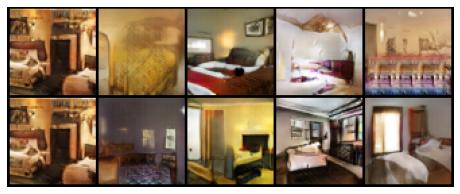

0it [00:00, ?it/s]

[45/50][0/2369]	Loss_D: 3.1878	Loss_G: 19.5468	D(x): 1.0000	D(G(z)): 0.8855 / 0.0000
[45/50][500/2369]	Loss_D: 0.0264	Loss_G: 6.4644	D(x): 0.9848	D(G(z)): 0.0095 / 0.0049
[45/50][1000/2369]	Loss_D: 0.0061	Loss_G: 7.8029	D(x): 0.9966	D(G(z)): 0.0027 / 0.0015
[45/50][1500/2369]	Loss_D: 0.0380	Loss_G: 6.4499	D(x): 0.9897	D(G(z)): 0.0224 / 0.0052
[45/50][2000/2369]	Loss_D: 0.0168	Loss_G: 5.9776	D(x): 0.9957	D(G(z)): 0.0121 / 0.0065


0it [00:00, ?it/s]

[46/50][0/2369]	Loss_D: 0.0323	Loss_G: 5.8776	D(x): 0.9830	D(G(z)): 0.0109 / 0.0068
[46/50][500/2369]	Loss_D: 0.0074	Loss_G: 5.9371	D(x): 0.9989	D(G(z)): 0.0063 / 0.0074
[46/50][1000/2369]	Loss_D: 0.0333	Loss_G: 6.5555	D(x): 0.9774	D(G(z)): 0.0072 / 0.0047
[46/50][1500/2369]	Loss_D: 0.0193	Loss_G: 6.0376	D(x): 0.9943	D(G(z)): 0.0132 / 0.0057
[46/50][2000/2369]	Loss_D: 0.0262	Loss_G: 6.0001	D(x): 0.9926	D(G(z)): 0.0172 / 0.0073


0it [00:00, ?it/s]

[47/50][0/2369]	Loss_D: 0.0355	Loss_G: 6.4713	D(x): 0.9957	D(G(z)): 0.0285 / 0.0049
[47/50][500/2369]	Loss_D: 0.0417	Loss_G: 5.2055	D(x): 0.9866	D(G(z)): 0.0259 / 0.0180
[47/50][1000/2369]	Loss_D: 0.0177	Loss_G: 6.8096	D(x): 0.9864	D(G(z)): 0.0034 / 0.0036
[47/50][1500/2369]	Loss_D: 0.1285	Loss_G: 5.4699	D(x): 0.9553	D(G(z)): 0.0602 / 0.0140
[47/50][2000/2369]	Loss_D: 0.0118	Loss_G: 6.7705	D(x): 0.9941	D(G(z)): 0.0057 / 0.0035


0it [00:00, ?it/s]

[48/50][0/2369]	Loss_D: 0.0576	Loss_G: 6.2374	D(x): 0.9912	D(G(z)): 0.0446 / 0.0057
[48/50][500/2369]	Loss_D: 0.0060	Loss_G: 7.3448	D(x): 0.9982	D(G(z)): 0.0041 / 0.0025
[48/50][1000/2369]	Loss_D: 0.0568	Loss_G: 4.6604	D(x): 0.9560	D(G(z)): 0.0081 / 0.0317
[48/50][1500/2369]	Loss_D: 0.0154	Loss_G: 6.6271	D(x): 0.9919	D(G(z)): 0.0068 / 0.0051
[48/50][2000/2369]	Loss_D: 0.0140	Loss_G: 6.4171	D(x): 0.9923	D(G(z)): 0.0061 / 0.0054


0it [00:00, ?it/s]

[49/50][0/2369]	Loss_D: 0.0095	Loss_G: 6.9974	D(x): 0.9938	D(G(z)): 0.0032 / 0.0025
[49/50][500/2369]	Loss_D: 0.0127	Loss_G: 6.5255	D(x): 0.9926	D(G(z)): 0.0051 / 0.0044
[49/50][1000/2369]	Loss_D: 0.6706	Loss_G: 5.0681	D(x): 0.9613	D(G(z)): 0.3747 / 0.0137
[49/50][1500/2369]	Loss_D: 0.0086	Loss_G: 6.7199	D(x): 0.9984	D(G(z)): 0.0068 / 0.0031
[49/50][2000/2369]	Loss_D: 0.0100	Loss_G: 6.8941	D(x): 0.9950	D(G(z)): 0.0049 / 0.0031
[50/50]	Loss_D: 0.0192	Loss_G: 6.3583	Fretchet_Distance: 203.5903


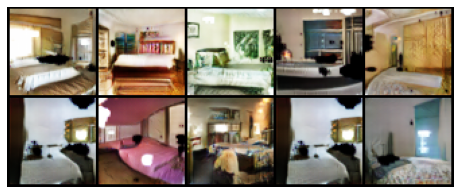

In [12]:
# Training Loop


lr = 2e-4
num_epochs = 50

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
print("Starting Training Loop...")

# Lists to keep track of progress
img_list = []
G_loss = []
D_loss = []
iters = 0
# For each epoch
for epoch in tqdm(range(num_epochs)):
    # For each batch in the dataloader
    for i, data in tqdm(enumerate(dataloader, 0)):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 500 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                % (epoch, num_epochs, i, len(dataloader),
                    errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_loss.append(errG.item())
        D_loss.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fixed_noise = torch.randn(ngf, nz, 1, 1, device=device)
                fake_display = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake_display, padding=2, normalize=True))

        iters += 1

    # G_loss.append(errG.item())
    # D_loss.append(errD.item())     
    fretchet_dist=calculate_fretchet(real_cpu,fake,model) 
    knn_distance_based = (
        NearestNeighbors(n_neighbors=5, metric="precomputed")
            .fit(torch.cdist(real_cpu[None].flatten(2).cpu().detach(), fake[None].flatten(2).cpu().detach())[0])
    )
    neigh = knn_distance_based.kneighbors(return_distance=False)
    if ((epoch+1)%5==0):
        
        print('[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tFretchet_Distance: %.4f'
                    % (epoch+1, num_epochs,
                        errD.item(), errG.item(),fretchet_dist))
        
        
        plt.figure(figsize=(8,8))
        plt.axis("off")
        pictures=vutils.make_grid(fake_display[torch.randint(len(fake_display), (10,))],nrow=5,padding=2, normalize=True)
        plt.imshow(np.transpose(pictures,(1,2,0)))
        plt.show()

In [20]:
# save preds
torch.save(fake, f'./../results/pred/dcgan_best.pt')

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 1.6988	Loss_G: 26.2742	D(x): 0.4054	D(G(z)): 0.4286 / 0.0000
[0/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 373.3137


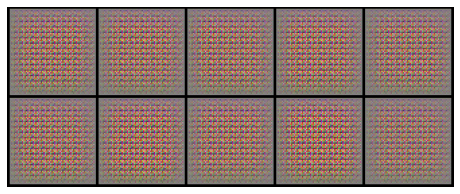

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 378.5143


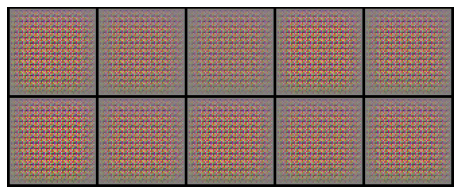

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[15/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 372.4674


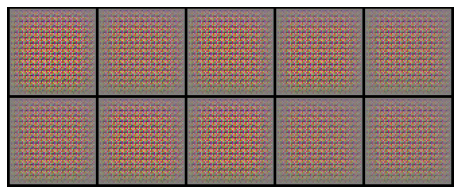

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 1.6150	Loss_G: 0.0000	D(x): 0.3383	D(G(z)): 0.2470 / 1.0000
[0/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 392.3502


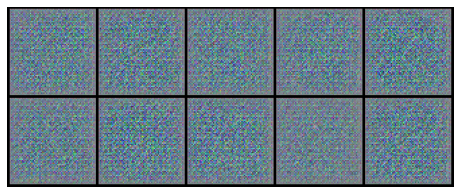

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 412.0421


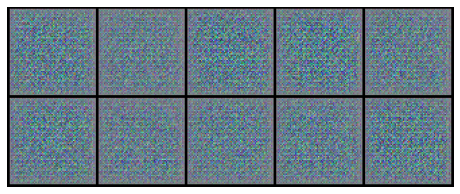

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[15/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 398.8971


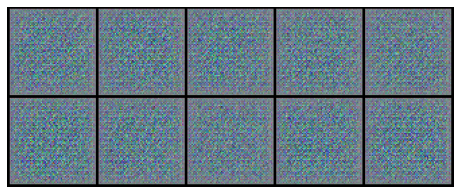

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 1.6737	Loss_G: 6.4077	D(x): 0.4899	D(G(z)): 0.5092 / 0.0024
[0/15][500/2369]	Loss_D: 1.0077	Loss_G: 3.4105	D(x): 0.4926	D(G(z)): 0.0240 / 0.0706
[0/15][1000/2369]	Loss_D: 0.3897	Loss_G: 3.8658	D(x): 0.8465	D(G(z)): 0.1459 / 0.0308
[0/15][1500/2369]	Loss_D: 0.3124	Loss_G: 3.3645	D(x): 0.8423	D(G(z)): 0.0737 / 0.0649
[0/15][2000/2369]	Loss_D: 0.6598	Loss_G: 7.1074	D(x): 0.9847	D(G(z)): 0.4021 / 0.0019


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 0.1243	Loss_G: 4.1819	D(x): 0.9257	D(G(z)): 0.0358 / 0.0393
[1/15][500/2369]	Loss_D: 0.2181	Loss_G: 4.0906	D(x): 0.8877	D(G(z)): 0.0781 / 0.0248
[1/15][1000/2369]	Loss_D: 0.2577	Loss_G: 4.1257	D(x): 0.8722	D(G(z)): 0.0824 / 0.0332
[1/15][1500/2369]	Loss_D: 0.3968	Loss_G: 2.6784	D(x): 0.7642	D(G(z)): 0.0787 / 0.1068
[1/15][2000/2369]	Loss_D: 0.8550	Loss_G: 2.5607	D(x): 0.5739	D(G(z)): 0.0815 / 0.1509


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 0.5739	Loss_G: 6.4905	D(x): 0.9477	D(G(z)): 0.3604 / 0.0025
[2/15][500/2369]	Loss_D: 1.7186	Loss_G: 2.6514	D(x): 0.2786	D(G(z)): 0.0038 / 0.1367
[2/15][1000/2369]	Loss_D: 0.3312	Loss_G: 4.3664	D(x): 0.9406	D(G(z)): 0.2096 / 0.0179
[2/15][1500/2369]	Loss_D: 0.1890	Loss_G: 4.0698	D(x): 0.8949	D(G(z)): 0.0643 / 0.0262
[2/15][2000/2369]	Loss_D: 0.2714	Loss_G: 4.5953	D(x): 0.9585	D(G(z)): 0.1842 / 0.0146


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 0.3848	Loss_G: 2.3106	D(x): 0.7401	D(G(z)): 0.0448 / 0.1381
[3/15][500/2369]	Loss_D: 0.6457	Loss_G: 1.5926	D(x): 0.5968	D(G(z)): 0.0409 / 0.2750
[3/15][1000/2369]	Loss_D: 0.2573	Loss_G: 3.4412	D(x): 0.9243	D(G(z)): 0.1499 / 0.0440
[3/15][1500/2369]	Loss_D: 0.4946	Loss_G: 2.8959	D(x): 0.6848	D(G(z)): 0.0428 / 0.0856
[3/15][2000/2369]	Loss_D: 0.3508	Loss_G: 4.3157	D(x): 0.9331	D(G(z)): 0.2261 / 0.0183


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 0.3245	Loss_G: 3.9307	D(x): 0.9515	D(G(z)): 0.2179 / 0.0274
[4/15][500/2369]	Loss_D: 0.2254	Loss_G: 2.8682	D(x): 0.8786	D(G(z)): 0.0787 / 0.0801
[4/15][1000/2369]	Loss_D: 0.4615	Loss_G: 5.1296	D(x): 0.9672	D(G(z)): 0.3105 / 0.0091
[4/15][1500/2369]	Loss_D: 0.4368	Loss_G: 2.8413	D(x): 0.7999	D(G(z)): 0.1477 / 0.0927
[4/15][2000/2369]	Loss_D: 0.3678	Loss_G: 4.0581	D(x): 0.9733	D(G(z)): 0.2622 / 0.0247
[5/15]	Loss_D: 0.1589	Loss_G: 4.2341	Fretchet_Distance: 248.3966


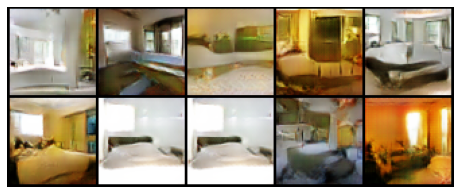

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 0.2035	Loss_G: 3.0132	D(x): 0.8888	D(G(z)): 0.0736 / 0.0712
[5/15][500/2369]	Loss_D: 0.1930	Loss_G: 3.0957	D(x): 0.9316	D(G(z)): 0.1027 / 0.0618
[5/15][1000/2369]	Loss_D: 1.2408	Loss_G: 2.9499	D(x): 0.8383	D(G(z)): 0.5645 / 0.0894
[5/15][1500/2369]	Loss_D: 0.4771	Loss_G: 4.8030	D(x): 0.9223	D(G(z)): 0.2838 / 0.0130
[5/15][2000/2369]	Loss_D: 0.2216	Loss_G: 2.0546	D(x): 0.8461	D(G(z)): 0.0405 / 0.1714


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 0.2498	Loss_G: 2.6755	D(x): 0.8186	D(G(z)): 0.0260 / 0.1158
[6/15][500/2369]	Loss_D: 0.4982	Loss_G: 4.2807	D(x): 0.9557	D(G(z)): 0.3253 / 0.0206
[6/15][1000/2369]	Loss_D: 0.1705	Loss_G: 3.2653	D(x): 0.9250	D(G(z)): 0.0809 / 0.0557
[6/15][1500/2369]	Loss_D: 0.3182	Loss_G: 5.3168	D(x): 0.9827	D(G(z)): 0.2358 / 0.0070
[6/15][2000/2369]	Loss_D: 0.1174	Loss_G: 3.0967	D(x): 0.9281	D(G(z)): 0.0374 / 0.0667


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 0.1185	Loss_G: 3.7370	D(x): 0.9545	D(G(z)): 0.0638 / 0.0376
[7/15][500/2369]	Loss_D: 0.1670	Loss_G: 2.7608	D(x): 0.8819	D(G(z)): 0.0284 / 0.0868
[7/15][1000/2369]	Loss_D: 0.1319	Loss_G: 3.9234	D(x): 0.9294	D(G(z)): 0.0520 / 0.0326
[7/15][1500/2369]	Loss_D: 0.3491	Loss_G: 2.5870	D(x): 0.7634	D(G(z)): 0.0390 / 0.1217
[7/15][2000/2369]	Loss_D: 0.0896	Loss_G: 3.8242	D(x): 0.9420	D(G(z)): 0.0265 / 0.0318


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 0.6749	Loss_G: 7.3105	D(x): 0.9924	D(G(z)): 0.4313 / 0.0011
[8/15][500/2369]	Loss_D: 0.1478	Loss_G: 3.5510	D(x): 0.9095	D(G(z)): 0.0384 / 0.0481
[8/15][1000/2369]	Loss_D: 0.1159	Loss_G: 4.7482	D(x): 0.9098	D(G(z)): 0.0155 / 0.0146
[8/15][1500/2369]	Loss_D: 0.2672	Loss_G: 2.3741	D(x): 0.8058	D(G(z)): 0.0243 / 0.1458
[8/15][2000/2369]	Loss_D: 0.1691	Loss_G: 4.1997	D(x): 0.9487	D(G(z)): 0.1008 / 0.0220


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 0.1231	Loss_G: 3.3199	D(x): 0.9177	D(G(z)): 0.0288 / 0.0550
[9/15][500/2369]	Loss_D: 0.1375	Loss_G: 4.2330	D(x): 0.9416	D(G(z)): 0.0658 / 0.0263
[9/15][1000/2369]	Loss_D: 0.2839	Loss_G: 1.9210	D(x): 0.7835	D(G(z)): 0.0117 / 0.2169
[9/15][1500/2369]	Loss_D: 0.1208	Loss_G: 3.5380	D(x): 0.9342	D(G(z)): 0.0460 / 0.0465
[9/15][2000/2369]	Loss_D: 0.2834	Loss_G: 4.4470	D(x): 0.9728	D(G(z)): 0.1982 / 0.0177
[10/15]	Loss_D: 0.2933	Loss_G: 6.8585	Fretchet_Distance: 209.3157


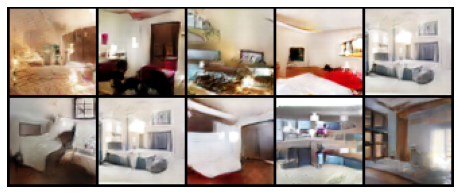

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 0.1377	Loss_G: 5.4822	D(x): 0.9801	D(G(z)): 0.0999 / 0.0076
[10/15][500/2369]	Loss_D: 0.1009	Loss_G: 4.0813	D(x): 0.9658	D(G(z)): 0.0600 / 0.0258
[10/15][1000/2369]	Loss_D: 0.1738	Loss_G: 3.0822	D(x): 0.8850	D(G(z)): 0.0382 / 0.0771
[10/15][1500/2369]	Loss_D: 0.1852	Loss_G: 4.1886	D(x): 0.9648	D(G(z)): 0.1252 / 0.0246
[10/15][2000/2369]	Loss_D: 0.0753	Loss_G: 4.4036	D(x): 0.9591	D(G(z)): 0.0299 / 0.0199


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 0.5689	Loss_G: 6.4841	D(x): 0.9946	D(G(z)): 0.3700 / 0.0025
[11/15][500/2369]	Loss_D: 0.0472	Loss_G: 5.1049	D(x): 0.9672	D(G(z)): 0.0117 / 0.0105
[11/15][1000/2369]	Loss_D: 0.2467	Loss_G: 4.9569	D(x): 0.9514	D(G(z)): 0.1472 / 0.0142
[11/15][1500/2369]	Loss_D: 0.0571	Loss_G: 4.7677	D(x): 0.9817	D(G(z)): 0.0361 / 0.0149
[11/15][2000/2369]	Loss_D: 0.2018	Loss_G: 2.8386	D(x): 0.8547	D(G(z)): 0.0254 / 0.1116


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 4.2062	Loss_G: 0.0002	D(x): 0.0481	D(G(z)): 0.0014 / 0.9998
[12/15][500/2369]	Loss_D: 0.5737	Loss_G: 1.7745	D(x): 0.7362	D(G(z)): 0.1699 / 0.2350
[12/15][1000/2369]	Loss_D: 0.1253	Loss_G: 4.1984	D(x): 0.9649	D(G(z)): 0.0787 / 0.0240
[12/15][1500/2369]	Loss_D: 0.0778	Loss_G: 4.8785	D(x): 0.9837	D(G(z)): 0.0566 / 0.0120
[12/15][2000/2369]	Loss_D: 0.1069	Loss_G: 3.9670	D(x): 0.9661	D(G(z)): 0.0666 / 0.0303


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 0.0625	Loss_G: 4.4982	D(x): 0.9753	D(G(z)): 0.0348 / 0.0193
[13/15][500/2369]	Loss_D: 0.0930	Loss_G: 3.8337	D(x): 0.9465	D(G(z)): 0.0337 / 0.0383
[13/15][1000/2369]	Loss_D: 0.2103	Loss_G: 3.3557	D(x): 0.8560	D(G(z)): 0.0270 / 0.0717
[13/15][1500/2369]	Loss_D: 0.0450	Loss_G: 5.3522	D(x): 0.9727	D(G(z)): 0.0159 / 0.0101
[13/15][2000/2369]	Loss_D: 0.0780	Loss_G: 4.4742	D(x): 0.9706	D(G(z)): 0.0437 / 0.0229


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 0.3364	Loss_G: 9.6834	D(x): 0.9984	D(G(z)): 0.2484 / 0.0001
[14/15][500/2369]	Loss_D: 0.0735	Loss_G: 4.3972	D(x): 0.9711	D(G(z)): 0.0410 / 0.0214
[14/15][1000/2369]	Loss_D: 0.1249	Loss_G: 3.3314	D(x): 0.9066	D(G(z)): 0.0160 / 0.0659
[14/15][1500/2369]	Loss_D: 0.2452	Loss_G: 7.2568	D(x): 0.9967	D(G(z)): 0.1914 / 0.0010
[14/15][2000/2369]	Loss_D: 0.0545	Loss_G: 4.8878	D(x): 0.9824	D(G(z)): 0.0347 / 0.0147
[15/15]	Loss_D: 0.1449	Loss_G: 5.2771	Fretchet_Distance: 213.5476


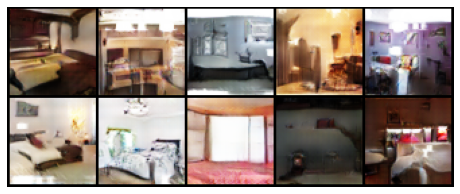

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 1.2796	Loss_G: 36.0963	D(x): 0.5652	D(G(z)): 0.4120 / 0.0000
[0/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[0/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[1/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[2/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[3/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[4/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 439.7867


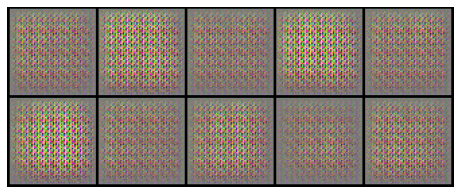

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[5/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[6/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[7/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[8/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[9/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 455.6980


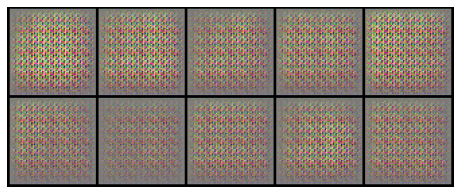

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[10/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[11/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[12/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[13/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][1500/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[14/15][2000/2369]	Loss_D: 100.0000	Loss_G: 0.0000	D(x): 1.0000	D(G(z)): 1.0000 / 1.0000
[15/15]	Loss_D: 100.0000	Loss_G: 0.0000	Fretchet_Distance: 434.7621


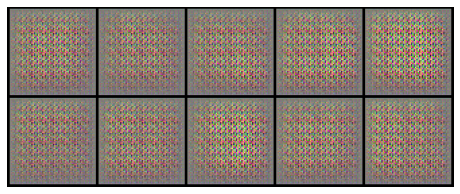

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 1.8132	Loss_G: 0.9921	D(x): 0.5066	D(G(z)): 0.5694 / 0.4371
[0/15][500/2369]	Loss_D: 0.0471	Loss_G: 4.9970	D(x): 0.9787	D(G(z)): 0.0166 / 0.0074
[0/15][1000/2369]	Loss_D: 0.0096	Loss_G: 5.8583	D(x): 0.9975	D(G(z)): 0.0070 / 0.0033
[0/15][1500/2369]	Loss_D: 0.0869	Loss_G: 4.8563	D(x): 0.9676	D(G(z)): 0.0492 / 0.0101
[0/15][2000/2369]	Loss_D: 0.0182	Loss_G: 5.6547	D(x): 0.9961	D(G(z)): 0.0141 / 0.0047


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 0.0753	Loss_G: 4.0426	D(x): 0.9611	D(G(z)): 0.0198 / 0.0239
[1/15][500/2369]	Loss_D: 0.0603	Loss_G: 5.0239	D(x): 0.9713	D(G(z)): 0.0279 / 0.0109
[1/15][1000/2369]	Loss_D: 0.0448	Loss_G: 4.9681	D(x): 0.9705	D(G(z)): 0.0098 / 0.0106
[1/15][1500/2369]	Loss_D: 0.0731	Loss_G: 4.3211	D(x): 0.9572	D(G(z)): 0.0260 / 0.0222
[1/15][2000/2369]	Loss_D: 0.1212	Loss_G: 3.2740	D(x): 0.9116	D(G(z)): 0.0137 / 0.0572


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 0.0392	Loss_G: 4.8848	D(x): 0.9779	D(G(z)): 0.0156 / 0.0128
[2/15][500/2369]	Loss_D: 0.1790	Loss_G: 4.3998	D(x): 0.9326	D(G(z)): 0.0885 / 0.0223
[2/15][1000/2369]	Loss_D: 0.1144	Loss_G: 3.9252	D(x): 0.9340	D(G(z)): 0.0389 / 0.0324
[2/15][1500/2369]	Loss_D: 0.0874	Loss_G: 3.4643	D(x): 0.9569	D(G(z)): 0.0364 / 0.0578
[2/15][2000/2369]	Loss_D: 0.1476	Loss_G: 7.0353	D(x): 0.9009	D(G(z)): 0.0072 / 0.0063


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 0.2341	Loss_G: 5.9905	D(x): 0.9864	D(G(z)): 0.1700 / 0.0057
[3/15][500/2369]	Loss_D: 0.0825	Loss_G: 4.6962	D(x): 0.9563	D(G(z)): 0.0315 / 0.0200
[3/15][1000/2369]	Loss_D: 0.1548	Loss_G: 6.1464	D(x): 0.9615	D(G(z)): 0.0981 / 0.0048
[3/15][1500/2369]	Loss_D: 0.1411	Loss_G: 4.4325	D(x): 0.9614	D(G(z)): 0.0828 / 0.0276
[3/15][2000/2369]	Loss_D: 0.1091	Loss_G: 4.6136	D(x): 0.9376	D(G(z)): 0.0328 / 0.0225


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 0.0617	Loss_G: 5.1770	D(x): 0.9562	D(G(z)): 0.0131 / 0.0138
[4/15][500/2369]	Loss_D: 0.3562	Loss_G: 5.5880	D(x): 0.9415	D(G(z)): 0.2044 / 0.0086
[4/15][1000/2369]	Loss_D: 0.1246	Loss_G: 3.9671	D(x): 0.9199	D(G(z)): 0.0299 / 0.0384
[4/15][1500/2369]	Loss_D: 0.1213	Loss_G: 5.2260	D(x): 0.9821	D(G(z)): 0.0803 / 0.0111
[4/15][2000/2369]	Loss_D: 0.0465	Loss_G: 4.5224	D(x): 0.9739	D(G(z)): 0.0179 / 0.0190
[5/15]	Loss_D: 0.0608	Loss_G: 4.9284	Fretchet_Distance: 294.8220


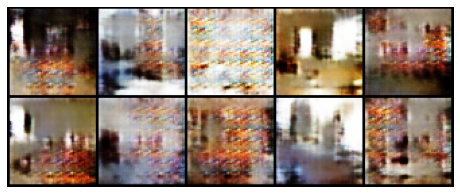

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 0.0291	Loss_G: 5.7498	D(x): 0.9900	D(G(z)): 0.0184 / 0.0076
[5/15][500/2369]	Loss_D: 0.1268	Loss_G: 5.0480	D(x): 0.9703	D(G(z)): 0.0834 / 0.0133
[5/15][1000/2369]	Loss_D: 0.0360	Loss_G: 5.5109	D(x): 0.9777	D(G(z)): 0.0118 / 0.0109
[5/15][1500/2369]	Loss_D: 0.1535	Loss_G: 4.9345	D(x): 0.8875	D(G(z)): 0.0025 / 0.0204
[5/15][2000/2369]	Loss_D: 0.0496	Loss_G: 5.6710	D(x): 0.9617	D(G(z)): 0.0080 / 0.0097


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 0.2040	Loss_G: 4.2176	D(x): 0.9136	D(G(z)): 0.0659 / 0.0522
[6/15][500/2369]	Loss_D: 0.0895	Loss_G: 5.3129	D(x): 0.9840	D(G(z)): 0.0638 / 0.0122
[6/15][1000/2369]	Loss_D: 0.0620	Loss_G: 4.6590	D(x): 0.9634	D(G(z)): 0.0217 / 0.0207
[6/15][1500/2369]	Loss_D: 0.0595	Loss_G: 5.2295	D(x): 0.9505	D(G(z)): 0.0042 / 0.0153
[6/15][2000/2369]	Loss_D: 0.0736	Loss_G: 5.1647	D(x): 0.9655	D(G(z)): 0.0295 / 0.0154


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 0.0990	Loss_G: 4.1597	D(x): 0.9344	D(G(z)): 0.0251 / 0.0357
[7/15][500/2369]	Loss_D: 0.0656	Loss_G: 5.1656	D(x): 0.9904	D(G(z)): 0.0497 / 0.0135
[7/15][1000/2369]	Loss_D: 0.0326	Loss_G: 5.4427	D(x): 0.9888	D(G(z)): 0.0201 / 0.0106
[7/15][1500/2369]	Loss_D: 0.0322	Loss_G: 5.5161	D(x): 0.9856	D(G(z)): 0.0167 / 0.0083
[7/15][2000/2369]	Loss_D: 0.0648	Loss_G: 5.1797	D(x): 0.9612	D(G(z)): 0.0189 / 0.0140


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 0.0411	Loss_G: 6.1475	D(x): 0.9704	D(G(z)): 0.0081 / 0.0067
[8/15][500/2369]	Loss_D: 2.5660	Loss_G: 12.3448	D(x): 0.9999	D(G(z)): 0.7682 / 0.0000
[8/15][1000/2369]	Loss_D: 0.0693	Loss_G: 4.3040	D(x): 0.9709	D(G(z)): 0.0351 / 0.0304
[8/15][1500/2369]	Loss_D: 0.0584	Loss_G: 4.9897	D(x): 0.9737	D(G(z)): 0.0288 / 0.0190
[8/15][2000/2369]	Loss_D: 0.0474	Loss_G: 5.4751	D(x): 0.9631	D(G(z)): 0.0073 / 0.0105


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 0.1916	Loss_G: 4.5366	D(x): 0.9904	D(G(z)): 0.1337 / 0.0310
[9/15][500/2369]	Loss_D: 0.0262	Loss_G: 5.5923	D(x): 0.9889	D(G(z)): 0.0142 / 0.0096
[9/15][1000/2369]	Loss_D: 0.0869	Loss_G: 4.5809	D(x): 0.9437	D(G(z)): 0.0168 / 0.0245
[9/15][1500/2369]	Loss_D: 0.0830	Loss_G: 4.8439	D(x): 0.9924	D(G(z)): 0.0669 / 0.0170
[9/15][2000/2369]	Loss_D: 0.0849	Loss_G: 4.5335	D(x): 0.9619	D(G(z)): 0.0371 / 0.0246
[10/15]	Loss_D: 0.0202	Loss_G: 5.7039	Fretchet_Distance: 297.4100


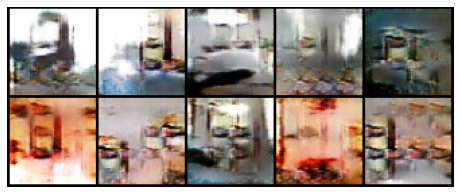

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 0.0587	Loss_G: 5.3848	D(x): 0.9833	D(G(z)): 0.0367 / 0.0141
[10/15][500/2369]	Loss_D: 0.0544	Loss_G: 5.0282	D(x): 0.9679	D(G(z)): 0.0189 / 0.0201
[10/15][1000/2369]	Loss_D: 0.0480	Loss_G: 5.0235	D(x): 0.9688	D(G(z)): 0.0145 / 0.0166
[10/15][1500/2369]	Loss_D: 0.0597	Loss_G: 4.8628	D(x): 0.9612	D(G(z)): 0.0163 / 0.0204
[10/15][2000/2369]	Loss_D: 0.0548	Loss_G: 4.9893	D(x): 0.9829	D(G(z)): 0.0349 / 0.0184


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 0.1186	Loss_G: 5.6261	D(x): 0.9936	D(G(z)): 0.0923 / 0.0089
[11/15][500/2369]	Loss_D: 0.1721	Loss_G: 5.2346	D(x): 0.9649	D(G(z)): 0.1111 / 0.0117
[11/15][1000/2369]	Loss_D: 0.0444	Loss_G: 5.2225	D(x): 0.9882	D(G(z)): 0.0295 / 0.0137
[11/15][1500/2369]	Loss_D: 0.0651	Loss_G: 4.7990	D(x): 0.9573	D(G(z)): 0.0167 / 0.0184
[11/15][2000/2369]	Loss_D: 0.0306	Loss_G: 6.3027	D(x): 0.9797	D(G(z)): 0.0090 / 0.0054


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 0.0373	Loss_G: 8.1689	D(x): 0.9669	D(G(z)): 0.0013 / 0.0009
[12/15][500/2369]	Loss_D: 0.0601	Loss_G: 5.2735	D(x): 0.9689	D(G(z)): 0.0251 / 0.0126
[12/15][1000/2369]	Loss_D: 0.1117	Loss_G: 5.0444	D(x): 0.9693	D(G(z)): 0.0652 / 0.0194
[12/15][1500/2369]	Loss_D: 0.0419	Loss_G: 4.6843	D(x): 0.9894	D(G(z)): 0.0280 / 0.0213
[12/15][2000/2369]	Loss_D: 0.1261	Loss_G: 4.1249	D(x): 0.9163	D(G(z)): 0.0201 / 0.0374


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 0.0722	Loss_G: 5.2016	D(x): 0.9940	D(G(z)): 0.0577 / 0.0122
[13/15][500/2369]	Loss_D: 0.0494	Loss_G: 4.9218	D(x): 0.9786	D(G(z)): 0.0254 / 0.0182
[13/15][1000/2369]	Loss_D: 0.0617	Loss_G: 4.8686	D(x): 0.9852	D(G(z)): 0.0422 / 0.0247
[13/15][1500/2369]	Loss_D: 0.0852	Loss_G: 4.8932	D(x): 0.9815	D(G(z)): 0.0562 / 0.0221
[13/15][2000/2369]	Loss_D: 0.0393	Loss_G: 5.4349	D(x): 0.9808	D(G(z)): 0.0184 / 0.0122


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 0.0829	Loss_G: 5.0780	D(x): 0.9805	D(G(z)): 0.0524 / 0.0159
[14/15][500/2369]	Loss_D: 0.2198	Loss_G: 2.9686	D(x): 0.8394	D(G(z)): 0.0146 / 0.1195
[14/15][1000/2369]	Loss_D: 0.0400	Loss_G: 4.2364	D(x): 0.9735	D(G(z)): 0.0105 / 0.0344
[14/15][1500/2369]	Loss_D: 0.0660	Loss_G: 5.2653	D(x): 0.9543	D(G(z)): 0.0114 / 0.0213
[14/15][2000/2369]	Loss_D: 0.0476	Loss_G: 6.3590	D(x): 0.9803	D(G(z)): 0.0254 / 0.0060
[15/15]	Loss_D: 0.0579	Loss_G: 5.2249	Fretchet_Distance: 250.3512


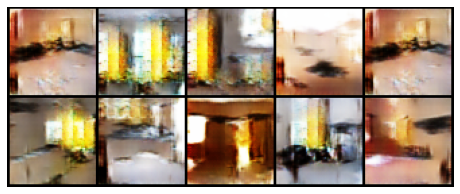

Starting Training Loop...


  0%|          | 0/15 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[0/15][0/2369]	Loss_D: 2.0745	Loss_G: 4.8369	D(x): 0.3663	D(G(z)): 0.4918 / 0.0112
[0/15][500/2369]	Loss_D: 0.0059	Loss_G: 7.0072	D(x): 0.9979	D(G(z)): 0.0037 / 0.0010
[0/15][1000/2369]	Loss_D: 0.0058	Loss_G: 7.5987	D(x): 0.9965	D(G(z)): 0.0022 / 0.0006
[0/15][1500/2369]	Loss_D: 0.0706	Loss_G: 4.4960	D(x): 0.9762	D(G(z)): 0.0394 / 0.0146
[0/15][2000/2369]	Loss_D: 0.0224	Loss_G: 5.9657	D(x): 0.9938	D(G(z)): 0.0154 / 0.0051


0it [00:00, ?it/s]

[1/15][0/2369]	Loss_D: 0.0453	Loss_G: 5.6535	D(x): 0.9819	D(G(z)): 0.0247 / 0.0054
[1/15][500/2369]	Loss_D: 0.2657	Loss_G: 2.7459	D(x): 0.8277	D(G(z)): 0.0283 / 0.0888
[1/15][1000/2369]	Loss_D: 0.5482	Loss_G: 1.6912	D(x): 0.6876	D(G(z)): 0.0946 / 0.2297
[1/15][1500/2369]	Loss_D: 0.0609	Loss_G: 4.6135	D(x): 0.9763	D(G(z)): 0.0344 / 0.0131
[1/15][2000/2369]	Loss_D: 0.8315	Loss_G: 2.2441	D(x): 0.5228	D(G(z)): 0.0066 / 0.1498


0it [00:00, ?it/s]

[2/15][0/2369]	Loss_D: 0.2438	Loss_G: 3.2458	D(x): 0.9111	D(G(z)): 0.1271 / 0.0517
[2/15][500/2369]	Loss_D: 0.2607	Loss_G: 4.9616	D(x): 0.9617	D(G(z)): 0.1823 / 0.0100
[2/15][1000/2369]	Loss_D: 0.1641	Loss_G: 3.2525	D(x): 0.9309	D(G(z)): 0.0814 / 0.0503
[2/15][1500/2369]	Loss_D: 0.3950	Loss_G: 1.8674	D(x): 0.7427	D(G(z)): 0.0362 / 0.1960
[2/15][2000/2369]	Loss_D: 0.2163	Loss_G: 3.2542	D(x): 0.9032	D(G(z)): 0.0915 / 0.0613


0it [00:00, ?it/s]

[3/15][0/2369]	Loss_D: 0.1953	Loss_G: 3.7601	D(x): 0.9257	D(G(z)): 0.1027 / 0.0362
[3/15][500/2369]	Loss_D: 0.1180	Loss_G: 3.6930	D(x): 0.9312	D(G(z)): 0.0361 / 0.0403
[3/15][1000/2369]	Loss_D: 0.1685	Loss_G: 3.5951	D(x): 0.9281	D(G(z)): 0.0807 / 0.0413
[3/15][1500/2369]	Loss_D: 0.1640	Loss_G: 3.3491	D(x): 0.8771	D(G(z)): 0.0213 / 0.0537
[3/15][2000/2369]	Loss_D: 0.1689	Loss_G: 3.9492	D(x): 0.9551	D(G(z)): 0.1052 / 0.0307


0it [00:00, ?it/s]

[4/15][0/2369]	Loss_D: 0.1482	Loss_G: 3.9215	D(x): 0.9420	D(G(z)): 0.0628 / 0.0402
[4/15][500/2369]	Loss_D: 0.1564	Loss_G: 3.6411	D(x): 0.8860	D(G(z)): 0.0180 / 0.0539
[4/15][1000/2369]	Loss_D: 0.1605	Loss_G: 3.8354	D(x): 0.9162	D(G(z)): 0.0573 / 0.0401
[4/15][1500/2369]	Loss_D: 0.1154	Loss_G: 3.5393	D(x): 0.9315	D(G(z)): 0.0363 / 0.0519
[4/15][2000/2369]	Loss_D: 0.0736	Loss_G: 4.9013	D(x): 0.9755	D(G(z)): 0.0429 / 0.0139
[5/15]	Loss_D: 0.0671	Loss_G: 5.4020	Fretchet_Distance: 329.3981


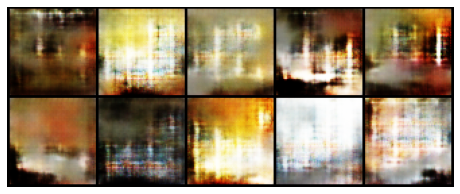

0it [00:00, ?it/s]

[5/15][0/2369]	Loss_D: 0.0867	Loss_G: 4.2656	D(x): 0.9540	D(G(z)): 0.0309 / 0.0286
[5/15][500/2369]	Loss_D: 0.0777	Loss_G: 4.3015	D(x): 0.9517	D(G(z)): 0.0245 / 0.0310
[5/15][1000/2369]	Loss_D: 0.0491	Loss_G: 5.9370	D(x): 0.9578	D(G(z)): 0.0012 / 0.0075
[5/15][1500/2369]	Loss_D: 0.0820	Loss_G: 4.6446	D(x): 0.9694	D(G(z)): 0.0434 / 0.0193
[5/15][2000/2369]	Loss_D: 0.0906	Loss_G: 4.1320	D(x): 0.9544	D(G(z)): 0.0357 / 0.0310


0it [00:00, ?it/s]

[6/15][0/2369]	Loss_D: 0.0873	Loss_G: 4.4492	D(x): 0.9353	D(G(z)): 0.0109 / 0.0246
[6/15][500/2369]	Loss_D: 0.0408	Loss_G: 4.9985	D(x): 0.9822	D(G(z)): 0.0217 / 0.0122
[6/15][1000/2369]	Loss_D: 0.1153	Loss_G: 4.3942	D(x): 0.9637	D(G(z)): 0.0573 / 0.0232
[6/15][1500/2369]	Loss_D: 0.0383	Loss_G: 4.8658	D(x): 0.9855	D(G(z)): 0.0220 / 0.0149
[6/15][2000/2369]	Loss_D: 0.0947	Loss_G: 4.4177	D(x): 0.9658	D(G(z)): 0.0541 / 0.0235


0it [00:00, ?it/s]

[7/15][0/2369]	Loss_D: 0.0954	Loss_G: 5.6475	D(x): 0.9246	D(G(z)): 0.0030 / 0.0132
[7/15][500/2369]	Loss_D: 0.1231	Loss_G: 5.4124	D(x): 0.9573	D(G(z)): 0.0683 / 0.0088
[7/15][1000/2369]	Loss_D: 0.2100	Loss_G: 3.5934	D(x): 0.8944	D(G(z)): 0.0678 / 0.0602
[7/15][1500/2369]	Loss_D: 0.0813	Loss_G: 4.0913	D(x): 0.9515	D(G(z)): 0.0251 / 0.0306
[7/15][2000/2369]	Loss_D: 0.1189	Loss_G: 4.8754	D(x): 0.9807	D(G(z)): 0.0860 / 0.0185


0it [00:00, ?it/s]

[8/15][0/2369]	Loss_D: 0.3947	Loss_G: 6.8269	D(x): 0.9728	D(G(z)): 0.2446 / 0.0024
[8/15][500/2369]	Loss_D: 0.1015	Loss_G: 3.9754	D(x): 0.9307	D(G(z)): 0.0232 / 0.0376
[8/15][1000/2369]	Loss_D: 0.0796	Loss_G: 4.3741	D(x): 0.9660	D(G(z)): 0.0398 / 0.0270
[8/15][1500/2369]	Loss_D: 0.0872	Loss_G: 3.8238	D(x): 0.9443	D(G(z)): 0.0258 / 0.0380
[8/15][2000/2369]	Loss_D: 0.0678	Loss_G: 4.7630	D(x): 0.9672	D(G(z)): 0.0214 / 0.0203


0it [00:00, ?it/s]

[9/15][0/2369]	Loss_D: 0.0883	Loss_G: 4.2446	D(x): 0.9292	D(G(z)): 0.0070 / 0.0321
[9/15][500/2369]	Loss_D: 0.1286	Loss_G: 3.3903	D(x): 0.9172	D(G(z)): 0.0244 / 0.0621
[9/15][1000/2369]	Loss_D: 0.0565	Loss_G: 4.5038	D(x): 0.9743	D(G(z)): 0.0280 / 0.0223
[9/15][1500/2369]	Loss_D: 0.1097	Loss_G: 4.4496	D(x): 0.9151	D(G(z)): 0.0068 / 0.0268
[9/15][2000/2369]	Loss_D: 0.0752	Loss_G: 4.2575	D(x): 0.9684	D(G(z)): 0.0393 / 0.0265
[10/15]	Loss_D: 0.0718	Loss_G: 5.2905	Fretchet_Distance: 288.6929


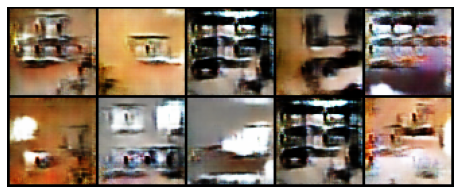

0it [00:00, ?it/s]

[10/15][0/2369]	Loss_D: 0.1785	Loss_G: 3.7567	D(x): 0.8921	D(G(z)): 0.0172 / 0.0543
[10/15][500/2369]	Loss_D: 0.0905	Loss_G: 4.0498	D(x): 0.9455	D(G(z)): 0.0254 / 0.0342
[10/15][1000/2369]	Loss_D: 0.0782	Loss_G: 4.2909	D(x): 0.9475	D(G(z)): 0.0196 / 0.0289
[10/15][1500/2369]	Loss_D: 0.4966	Loss_G: 3.4609	D(x): 0.6769	D(G(z)): 0.0010 / 0.0836
[10/15][2000/2369]	Loss_D: 0.0718	Loss_G: 4.2814	D(x): 0.9664	D(G(z)): 0.0341 / 0.0261


0it [00:00, ?it/s]

[11/15][0/2369]	Loss_D: 0.3130	Loss_G: 2.4459	D(x): 0.8051	D(G(z)): 0.0052 / 0.2018
[11/15][500/2369]	Loss_D: 0.0939	Loss_G: 4.2472	D(x): 0.9555	D(G(z)): 0.0360 / 0.0269
[11/15][1000/2369]	Loss_D: 0.1158	Loss_G: 3.7515	D(x): 0.9115	D(G(z)): 0.0168 / 0.0476
[11/15][1500/2369]	Loss_D: 1.7065	Loss_G: 10.9859	D(x): 0.9993	D(G(z)): 0.6954 / 0.0001
[11/15][2000/2369]	Loss_D: 0.1980	Loss_G: 4.7975	D(x): 0.9677	D(G(z)): 0.1223 / 0.0171


0it [00:00, ?it/s]

[12/15][0/2369]	Loss_D: 0.0711	Loss_G: 4.4827	D(x): 0.9759	D(G(z)): 0.0415 / 0.0265
[12/15][500/2369]	Loss_D: 1.7316	Loss_G: 0.0032	D(x): 0.3036	D(G(z)): 0.0005 / 0.9968
[12/15][1000/2369]	Loss_D: 0.1351	Loss_G: 3.5904	D(x): 0.9309	D(G(z)): 0.0509 / 0.0518
[12/15][1500/2369]	Loss_D: 0.0453	Loss_G: 5.1675	D(x): 0.9921	D(G(z)): 0.0342 / 0.0156
[12/15][2000/2369]	Loss_D: 0.1110	Loss_G: 4.4481	D(x): 0.9496	D(G(z)): 0.0471 / 0.0323


0it [00:00, ?it/s]

[13/15][0/2369]	Loss_D: 1.9101	Loss_G: 9.7065	D(x): 0.9999	D(G(z)): 0.7529 / 0.0002
[13/15][500/2369]	Loss_D: 0.0679	Loss_G: 4.7470	D(x): 0.9714	D(G(z)): 0.0333 / 0.0196
[13/15][1000/2369]	Loss_D: 0.1103	Loss_G: 4.9098	D(x): 0.9252	D(G(z)): 0.0114 / 0.0258
[13/15][1500/2369]	Loss_D: 0.0955	Loss_G: 4.8436	D(x): 0.9727	D(G(z)): 0.0466 / 0.0223
[13/15][2000/2369]	Loss_D: 0.0518	Loss_G: 5.3506	D(x): 0.9911	D(G(z)): 0.0376 / 0.0151


0it [00:00, ?it/s]

[14/15][0/2369]	Loss_D: 0.4135	Loss_G: 7.8856	D(x): 0.9962	D(G(z)): 0.2804 / 0.0008
[14/15][500/2369]	Loss_D: 0.0610	Loss_G: 4.7911	D(x): 0.9757	D(G(z)): 0.0330 / 0.0208
[14/15][1000/2369]	Loss_D: 0.1015	Loss_G: 4.0911	D(x): 0.9337	D(G(z)): 0.0245 / 0.0375
[14/15][1500/2369]	Loss_D: 0.1216	Loss_G: 4.4503	D(x): 0.9548	D(G(z)): 0.0651 / 0.0282
[14/15][2000/2369]	Loss_D: 0.0918	Loss_G: 4.4403	D(x): 0.9437	D(G(z)): 0.0255 / 0.0297
[15/15]	Loss_D: 0.5770	Loss_G: 1.1317	Fretchet_Distance: 268.4968


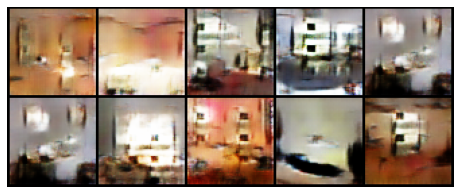

In [12]:
# Training Loop

lrs = [2e-3, 2e-4, 2e-5]
originals = []
predictions = []
fids = []
neighbours = []
G_losses = []
D_losses = []
for lr in lrs:
    lr_originals = []
    lr_preds = []
    lr_fids = []
    lr_nn = []
    lr_g_losses = []
    lr_d_losses = []
    for o in range(2):

        # Create the generator
        netG = Generator(ngpu).to(device)

        # Handle multi-gpu if desired
        if (device.type == 'cuda') and (ngpu > 1):
            netG = nn.DataParallel(netG, list(range(ngpu)))

        # Apply the weights_init function to randomly initialize all weights
        #  to mean=0, stdev=0.02.
        netG.apply(weights_init)

        # Create the Discriminator
        netD = Discriminator(ngpu).to(device)

        # Handle multi-gpu if desired
        if (device.type == 'cuda') and (ngpu > 1):
            netD = nn.DataParallel(netD, list(range(ngpu)))

        # Apply the weights_init function to randomly initialize all weights
        #  to mean=0, stdev=0.2.
        netD.apply(weights_init)

        if o == 0:
            optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
            optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
        else:
            optimizerD = optim.RMSprop(netD.parameters(), lr=lr, alpha=0.99)
            optimizerG = optim.RMSprop(netG.parameters(), lr=lr, alpha=0.99)

        print("Starting Training Loop...")

        # Lists to keep track of progress
        img_list = []
        G_loss = []
        D_loss = []
        iters = 0
        # For each epoch
        for epoch in tqdm(range(num_epochs)):
            # For each batch in the dataloader
            for i, data in tqdm(enumerate(dataloader, 0)):

                ############################
                # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
                ###########################
                ## Train with all-real batch
                netD.zero_grad()
                # Format batch
                real_cpu = data[0].to(device)
                b_size = real_cpu.size(0)
                label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
                # Forward pass real batch through D
                output = netD(real_cpu).view(-1)
                # Calculate loss on all-real batch
                errD_real = criterion(output, label)
                # Calculate gradients for D in backward pass
                errD_real.backward()
                D_x = output.mean().item()

                ## Train with all-fake batch
                # Generate batch of latent vectors
                noise = torch.randn(b_size, nz, 1, 1, device=device)
                # Generate fake image batch with G
                fake = netG(noise)
                label.fill_(fake_label)
                # Classify all fake batch with D
                output = netD(fake.detach()).view(-1)
                # Calculate D's loss on the all-fake batch
                errD_fake = criterion(output, label)
                # Calculate the gradients for this batch, accumulated (summed) with previous gradients
                errD_fake.backward()
                D_G_z1 = output.mean().item()
                # Compute error of D as sum over the fake and the real batches
                errD = errD_real + errD_fake
                # Update D
                optimizerD.step()

                ############################
                # (2) Update G network: maximize log(D(G(z)))
                ###########################
                netG.zero_grad()
                label.fill_(real_label)  # fake labels are real for generator cost
                # Since we just updated D, perform another forward pass of all-fake batch through D
                output = netD(fake).view(-1)
                # Calculate G's loss based on this output
                errG = criterion(output, label)
                # Calculate gradients for G
                errG.backward()
                D_G_z2 = output.mean().item()
                # Update G
                optimizerG.step()

                # Output training stats
                if i % 500 == 0:
                    print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                        % (epoch, num_epochs, i, len(dataloader),
                            errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

                # Save Losses for plotting later
                # G_loss.append(errG.item())
                # D_loss.append(errD.item())

                # Check how the generator is doing by saving G's output on fixed_noise
                if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
                    with torch.no_grad():
                        fixed_noise = torch.randn(ngf, nz, 1, 1, device=device)
                        fake_display = netG(fixed_noise).detach().cpu()
                    img_list.append(vutils.make_grid(fake_display, padding=2, normalize=True))

                iters += 1

            G_loss.append(errG.item())
            D_loss.append(errD.item())     
            fretchet_dist=calculate_fretchet(real_cpu,fake,model) 
            knn_distance_based = (
                NearestNeighbors(n_neighbors=5, metric="precomputed")
                    .fit(torch.cdist(real_cpu[None].flatten(2).cpu().detach(), fake[None].flatten(2).cpu().detach())[0])
            )
            neigh = knn_distance_based.kneighbors(return_distance=False)
            if ((epoch+1)%5==0):
                
                print('[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tFretchet_Distance: %.4f'
                            % (epoch+1, num_epochs,
                                errD.item(), errG.item(),fretchet_dist))
                
                
                plt.figure(figsize=(8,8))
                plt.axis("off")
                pictures=vutils.make_grid(fake_display[torch.randint(len(fake_display), (10,))],nrow=5,padding=2, normalize=True)
                plt.imshow(np.transpose(pictures,(1,2,0)))
                plt.show()
        lr_g_losses.append(G_loss)
        lr_d_losses.append(D_loss)
        lr_originals.append(real_cpu)
        lr_preds.append(fake)
        lr_fids.append(fretchet_dist)
        lr_nn.append(neigh)
    G_losses.append(lr_g_losses)
    D_losses.append(lr_d_losses)
    originals.append(lr_originals)
    predictions.append(lr_preds)
    fids.append(lr_fids)
    neighbours.append(lr_nn)

In [14]:
# save fid
fid_df = pd.DataFrame(fids)
fid_df.columns = ['Adam', 'RMSProp']
fid_df.index = ['2e-3', '2e-4', '2e-5']
fid_df.to_csv('./../results/fid/dcgan_fid_scores.csv')

In [15]:
# save knn
for i, nn in enumerate(neighbours):
    for j, nnn in enumerate(nn):
        knn_df = pd.DataFrame(nnn)

        knn_df.columns = ['n1', 'n2', 'n3', 'n4', 'n5']

        knn_df.to_csv(f'./../results/knn/gan_neighbours_orig_{i}_{j}.csv', index=False)

In [16]:
# save preds
for i, pred in enumerate(predictions):
    for j, p in enumerate(pred):
        torch.save(p, f'./../results/pred/gan_predictions_{i}_{j}.pt')

In [17]:
# save orig
for i, orig in enumerate(originals):
    for j, o in enumerate(orig):
        torch.save(p, f'./../results/orig/gan_predictions_{i}_{j}.pt')

In [21]:
# save losses
for i, loss in enumerate(G_losses):
    for j, g in enumerate(loss):
        d = D_losses[i][j]
        loss_df = pd.DataFrame([g,d]).T
        loss_df.columns = ['G_loss', 'D_loss']
        loss_df.to_csv(f'./../results/loss/gan_loss_{i}_{j}.csv')


### <span style='font-family:Georgia'> Results

#### <span style='font-family:Georgia'> Visualization of G’s progression

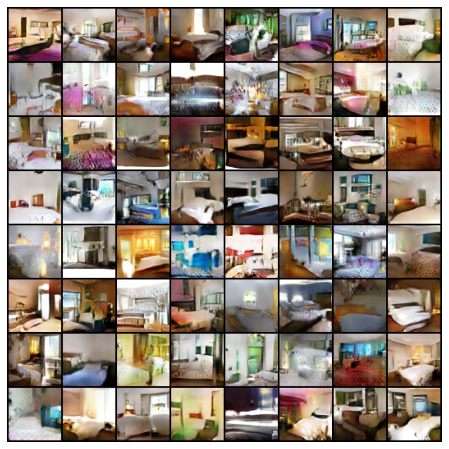

In [16]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

#### <span style='font-family:Georgia'> Real Images vs. Fake Images

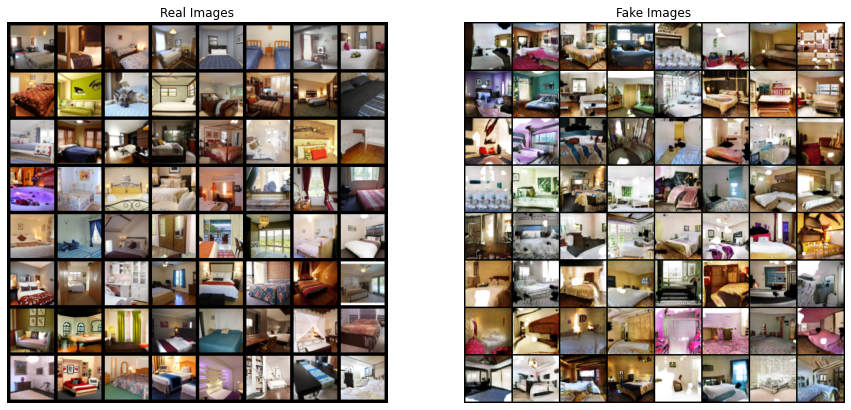

In [18]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

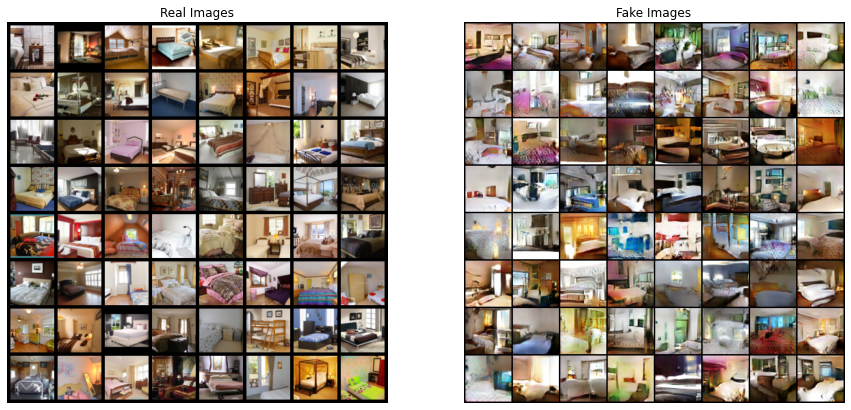

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [25]:
# example of interpolating between generated images
from numpy import asarray
from numpy.random import randn
from numpy.random import randint
from numpy import linspace
from matplotlib import pyplot

# uniform interpolation between two points in latent space
def interpolate_points(p1, p2, n_steps=10):
	# interpolate ratios between the points
	ratios = linspace(0, 1, num=n_steps)
	# linear interpolate vectors
	vectors = list()
	for ratio in ratios:
		v = (1.0 - ratio) * p1 + ratio * p2
		vectors.append(v)
	return asarray(vectors)

In [39]:
# import required libraries
import torch
import torchvision.transforms as T
from PIL import Image

In [94]:
interpolated = interpolate_points(noise[0].cpu().detach().numpy(), noise[1].cpu().detach().numpy())
# generate images
X = netG(torch.Tensor(interpolated)).cpu()
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0

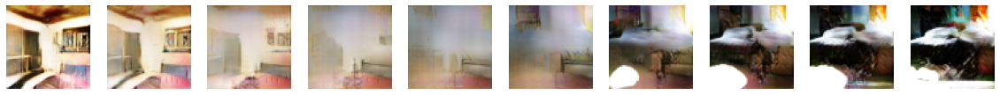

In [95]:
plt.figure(figsize=(20,10))

for i in range(10):
    x = X[i]
    # define subplot
    plt.subplot(1, 10, 1 + i)
    # turn off axis
    plt.axis('off')
    # plot raw pixel data
    plt.imshow(x.detach().permute(1,2,0))
plt.show()
